# Продолжение кода по композитным материалам

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import tensorflow as tf
import seaborn as sns
import plotly.express as px
import tensorflow as tf
import sklearn

from sklearn import linear_model
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.linear_model import LinearRegression, LogisticRegression, SGDRegressor
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_percentage_error, mean_absolute_error
from sklearn.model_selection import train_test_split, GridSearchCV, KFold, cross_val_score
from sklearn.neighbors import KNeighborsRegressor
from sklearn.neural_network import MLPRegressor
from sklearn.pipeline import make_pipeline, Pipeline
from sklearn import preprocessing
from sklearn.preprocessing import Normalizer, LabelEncoder, MinMaxScaler, StandardScaler
from sklearn.svm import SVR
from sklearn.tree import DecisionTreeRegressor

from tensorflow import keras as keras
from tensorflow.keras import layers
from tensorflow.keras.layers import Dense, Flatten, Dropout, BatchNormalization, Activation
from pandas import read_excel, DataFrame, Series
from keras.wrappers.scikit_learn import KerasClassifier, KerasRegressor
from tensorflow.keras.models import Sequential
from numpy.random import seed
from scipy import stats
import warnings
warnings.filterwarnings("ignore")

In [2]:
df = pd.read_excel(r"C:\Users\Avona\Desktop\Моя ВКР\Itog\itog.xlsx")

In [3]:
#Создадим переменную для названия всех столбцов. Это нам пригодится при построении моделей. И перейдем к визуализации данных
df.columns
#column_names = ["Соотношение матрица-наполнитель","Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%",
#         "Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2",
#         "Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2",
#        "Угол нашивки, град","Шаг нашивки","Плотность нашивки"]
column_names = df.columns

# Проведем предобработку данных

In [4]:
#Вспомним, что пропуски в данных отсутствуют. Значит, сразу приступаем к работе с выбросами
# Шаг 1 Удаление выбросов. Посчитаем, сколько значений у нас в каждом столбце выбивающихся из распределения.
df.isna().sum()
#Т.к.значений не очень много, их вполне можно исключить.

Unnamed: 0                              0
Соотношение матрица-наполнитель         0
Плотность, кг/м3                        0
модуль упругости, ГПа                   0
Количество отвердителя, м.%             0
Содержание эпоксидных групп,%_2         0
Температура вспышки, С_2                0
Поверхностная плотность, г/м2           0
Модуль упругости при растяжении, ГПа    0
Прочность при растяжении, МПа           0
Потребление смолы, г/м2                 0
Угол нашивки                            0
Шаг нашивки                             0
Плотность нашивки                       0
dtype: int64

In [5]:
#Для удаления выбросов существует 2 основных метода - метод 3-х сигм и межквартильных расстояний. Сравним эти 2 метода.
metod_3s = 0
metod_iq = 0
count_iq = [] # Список, куда записывается количество выбросов по каждой колонке датафрейма методом.
count_3s = [] # Список, куда записывается количество выбросов по каждой колонке датафрейма.
for column in df:
    d = df.loc[:, [column]]
    # методом 3-х сигм
    zscore = (df[column] - df[column].mean()) / df[column].std()
    d['3s'] = zscore.abs() > 3
    metod_3s += d['3s'].sum()
    count_3s.append(d['3s'].sum())
    print(column,'3s', ': ', d['3s'].sum())

    # методом межквартильных расстояний
    q1 = np.quantile(df[column], 0.25)
    q3 = np.quantile(df[column], 0.75)
    iqr = q3 - q1
    lower = q1 - 1.5 * iqr
    upper = q3 + 1.5 * iqr
    d['iq'] = (df[column] <= lower) | (df[column] >= upper)
    metod_iq += d['iq'].sum()
    count_iq.append(d['iq'].sum())
    print(column, ': ', d['iq'].sum())
print('Метод 3-х сигм, выбросов:', metod_3s)
print('Метод межквартильных расстояний, выбросов:', metod_iq)

Unnamed: 0 3s :  0
Unnamed: 0 :  0
Соотношение матрица-наполнитель 3s :  0
Соотношение матрица-наполнитель :  0
Плотность, кг/м3 3s :  0
Плотность, кг/м3 :  0
модуль упругости, ГПа 3s :  0
модуль упругости, ГПа :  0
Количество отвердителя, м.% 3s :  0
Количество отвердителя, м.% :  0
Содержание эпоксидных групп,%_2 3s :  0
Содержание эпоксидных групп,%_2 :  0
Температура вспышки, С_2 3s :  0
Температура вспышки, С_2 :  0
Поверхностная плотность, г/м2 3s :  0
Поверхностная плотность, г/м2 :  0
Модуль упругости при растяжении, ГПа 3s :  0
Модуль упругости при растяжении, ГПа :  0
Прочность при растяжении, МПа 3s :  0
Прочность при растяжении, МПа :  0
Потребление смолы, г/м2 3s :  0
Потребление смолы, г/м2 :  0
Угол нашивки 3s :  0
Угол нашивки :  0
Шаг нашивки 3s :  0
Шаг нашивки :  0
Плотность нашивки 3s :  0
Плотность нашивки :  0
Метод 3-х сигм, выбросов: 0
Метод межквартильных расстояний, выбросов: 0


In [6]:
# С целью предотвращения удаления особенностей признака или допущения ошибки, посчитаем распределение выбросов по каждому столбцу.

In [7]:
m = df.copy()
for i in df.columns:
    m[i] = abs((df[i] - df[i].mean()) / df[i].std())
    print(f"{sum(m[i] > 3)} выбросов в признаке {i}")
print(f' Всего {sum(sum(m.values > 3))} выброса')

0 выбросов в признаке Unnamed: 0
0 выбросов в признаке Соотношение матрица-наполнитель
0 выбросов в признаке Плотность, кг/м3
0 выбросов в признаке модуль упругости, ГПа
0 выбросов в признаке Количество отвердителя, м.%
0 выбросов в признаке Содержание эпоксидных групп,%_2
0 выбросов в признаке Температура вспышки, С_2
0 выбросов в признаке Поверхностная плотность, г/м2
0 выбросов в признаке Модуль упругости при растяжении, ГПа
0 выбросов в признаке Прочность при растяжении, МПа
0 выбросов в признаке Потребление смолы, г/м2
0 выбросов в признаке Угол нашивки
0 выбросов в признаке Шаг нашивки
0 выбросов в признаке Плотность нашивки
 Всего 0 выброса


In [8]:
# Результаты показывают, что выбросы распределены по разным признакам. Какого-то скопления выбросов в одном из признаков не обнаружено. Поэтому можно удалять выбросы, потому что глобальных изменений в зависимостях они не дадут.

In [9]:
#Создадим переменную со списком всех параметров, в которых есть выбросы
df.columns
column_list_drop = ["Соотношение матрица-наполнитель",
                 "Плотность, кг/м3",
                 "модуль упругости, ГПа",
                 "Количество отвердителя, м.%",
                 "Содержание эпоксидных групп,%_2",
                 "Температура вспышки, С_2",
                 "Поверхностная плотность, г/м2",
                 "Модуль упругости при растяжении, ГПа",
                 "Прочность при растяжении, МПа",
                 "Потребление смолы, г/м2",
                 "Шаг нашивки",
                 "Плотность нашивки"]

In [10]:
# Исключим выбросы, очистим данные от выбросов методом межквартильного расстояния (далее 1,5 межквартильных размахов)
# Выбор сделан в пользу этого метода, потому что хотим добиться в данной работе полностью избавления от выборов, и метод межквартильного расстояния позволяет удалить практически 10% датасета сразу
for i in column_list_drop:
    q75, q25 = np.percentile(df.loc[:,i], [75,25])
    intr_qr = q75 - q25
    max = q75 + (1.5 * intr_qr)
    min = q25 - (1.5 * intr_qr)
    df.loc[df[i] < min, i] = np.nan
    df.loc[df[i] > max, i] = np.nan

In [11]:
# Так же для удаления выбросов можно использовать вот эту формулу, но мне привычней вариант выше:
#df = df[~((df<(min))|(df>(max))).any(axis=1)]
#df

In [12]:
# Можно так же удалить выборосы методом 3-х сигм, но мы не будем. Просто отсвим код здесь на будущее
m_3s = pd.DataFrame(index=df.index)
for column in df:
    zscore = (df[column] - df[column].mean()) / df[column].std()
    m_3s[column] = (zscore.abs() > 3)
df = df[m_3s.sum(axis=1)==0]
df.shape

(922, 14)

In [13]:
#Посмотрим на сумму выбросов по каждому из столбцов
df.isnull().sum()
#Всего 64 выброса, можно их удалить.

Unnamed: 0                              0
Соотношение матрица-наполнитель         0
Плотность, кг/м3                        0
модуль упругости, ГПа                   0
Количество отвердителя, м.%             0
Содержание эпоксидных групп,%_2         0
Температура вспышки, С_2                0
Поверхностная плотность, г/м2           0
Модуль упругости при растяжении, ГПа    0
Прочность при растяжении, МПа           0
Потребление смолы, г/м2                 0
Угол нашивки                            0
Шаг нашивки                             0
Плотность нашивки                       0
dtype: int64

In [14]:
#Удаляем строки c выбросами
df = df.dropna(axis=0)

In [15]:
#И еще раз посмотрим на сумму выбросов по каждому из столбцов, чтобы убедиться, что все работает
df.isnull().sum()

Unnamed: 0                              0
Соотношение матрица-наполнитель         0
Плотность, кг/м3                        0
модуль упругости, ГПа                   0
Количество отвердителя, м.%             0
Содержание эпоксидных групп,%_2         0
Температура вспышки, С_2                0
Поверхностная плотность, г/м2           0
Модуль упругости при растяжении, ГПа    0
Прочность при растяжении, МПа           0
Потребление смолы, г/м2                 0
Угол нашивки                            0
Шаг нашивки                             0
Плотность нашивки                       0
dtype: int64

In [16]:
#Просмотрим информацию о "чистом" датасете после удаления пропусков. Видим, что строк стало меньше
df.info()
# После удаления выбросов в датасете осталось 936 строк и 13 колонок

<class 'pandas.core.frame.DataFrame'>
Int64Index: 922 entries, 0 to 921
Data columns (total 14 columns):
 #   Column                                Non-Null Count  Dtype  
---  ------                                --------------  -----  
 0   Unnamed: 0                            922 non-null    int64  
 1   Соотношение матрица-наполнитель       922 non-null    float64
 2   Плотность, кг/м3                      922 non-null    float64
 3   модуль упругости, ГПа                 922 non-null    float64
 4   Количество отвердителя, м.%           922 non-null    float64
 5   Содержание эпоксидных групп,%_2       922 non-null    float64
 6   Температура вспышки, С_2              922 non-null    float64
 7   Поверхностная плотность, г/м2         922 non-null    float64
 8   Модуль упругости при растяжении, ГПа  922 non-null    float64
 9   Прочность при растяжении, МПа         922 non-null    float64
 10  Потребление смолы, г/м2               922 non-null    float64
 11  Угол нашивки       

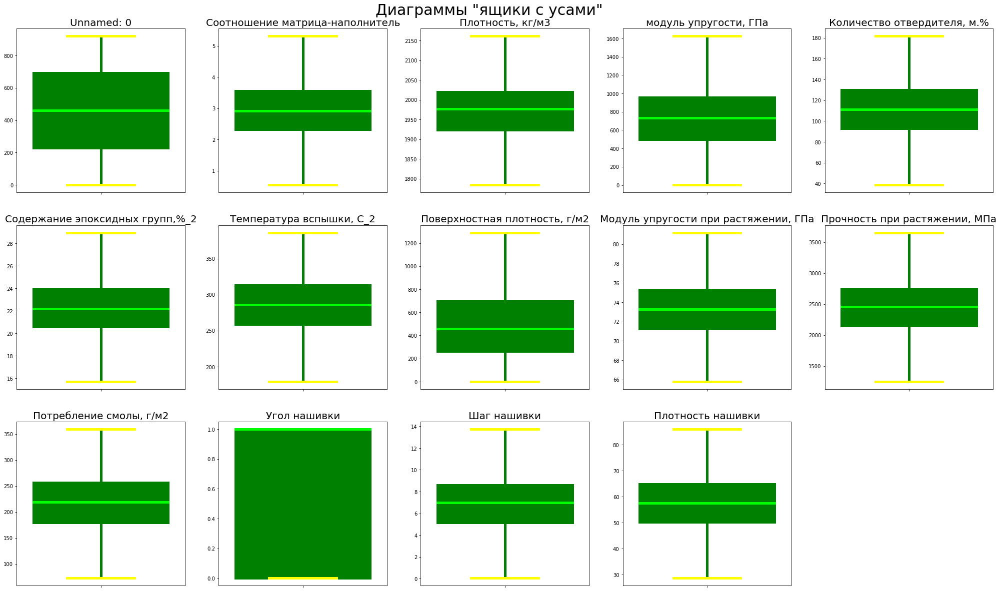

In [17]:
# Ящики с усами (второй вариант)
a = 5 # количество строк
b = 5 # количество столцбцов
c = 1 # инициализация plot counter

plt.figure(figsize = (35,35))
plt.suptitle('Диаграммы "ящики с усами"', y = 0.9 ,
             fontsize = 30)
for col in df.columns:
    plt.subplot(a, b, c)
    #plt.figure(figsize=(7,5))
    sns.boxplot(data = df, y = df[col], fliersize = 15, linewidth = 5, boxprops = dict(facecolor = 'y', color = 'g'), medianprops = dict(color = 'lime'), whiskerprops = dict(color = "g"), capprops = dict(color="yellow"), flierprops = dict(color = "y", markeredgecolor = "lime"))
    plt.ylabel(None)
    plt.title(col, size = 20)
    #plt.show()
    c += 1

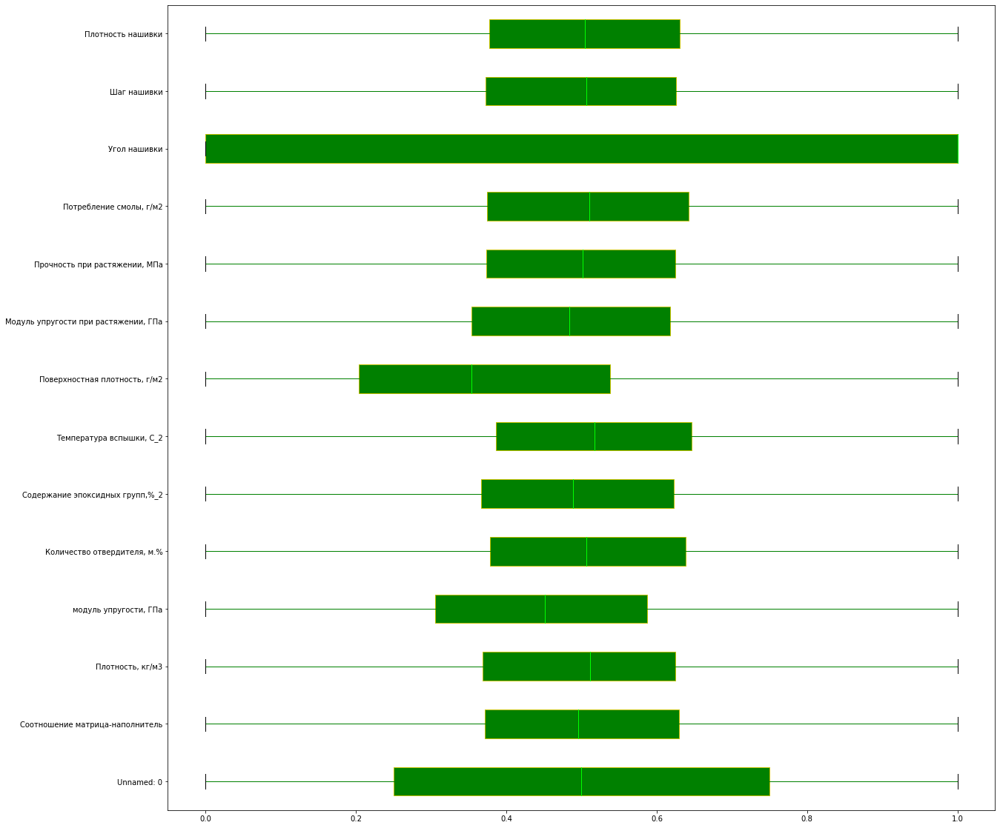

In [18]:
#Построим "ящики с усами" и наблюдаем все еще наличие выбросов
scaler = MinMaxScaler()
scaler.fit(df)
plt.figure(figsize = (20, 20))
#Посмотрим на  "ящики с усами",чтобы наглядно увидеть, что выбросов нет, но они есть
plt.boxplot(pd.DataFrame(scaler.transform(df)), labels = df.columns,patch_artist = True, meanline = True, vert = False, boxprops = dict(facecolor = 'g', color = 'y'),medianprops = dict(color = 'lime'), whiskerprops = dict(color = "g"), capprops = dict(color = "black"), flierprops = dict(color = "y", markeredgecolor = "maroon"))
plt.show()


In [19]:
# На графиках выше мы видим выбросы в некоторых столбцах. Они всё ещё есть, поэтому повторяем удаление выбросов

for i in column_list_drop:
    q75, q25 = np.percentile(df.loc[:,i],[75, 25])
    intr_qr = q75 - q25
    max = q75 + (1.5 * intr_qr)
    min = q25 - (1.5 * intr_qr)
    df.loc[df[i] < min, i] = np.nan
    df.loc[df[i] > max, i] = np.nan

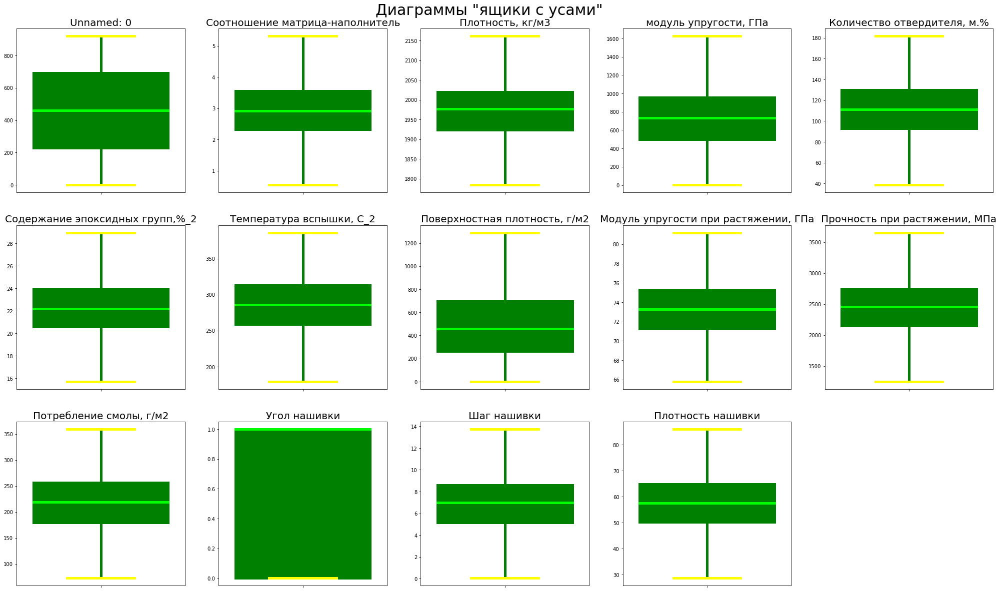

In [20]:
# Ящики с усами (второй вариант)
a = 5 # количество строк
b = 5 # количество столцбцов
c = 1 # инициализация plot counter

plt.figure(figsize=(35,35))
plt.suptitle('Диаграммы "ящики с усами"', y = 0.9 ,
             fontsize = 30)
for col in df.columns:
    plt.subplot(a, b, c)
    #plt.figure(figsize=(7,5))
    sns.boxplot(data = df, y = df[col], fliersize = 15, linewidth = 5, boxprops = dict(facecolor = 'y', color = 'g'), medianprops = dict(color = 'lime'), whiskerprops = dict(color = "g"), capprops = dict(color="yellow"), flierprops = dict(color = "y", markeredgecolor = "lime"))
    plt.ylabel(None)
    plt.title(col, size = 20)
    #plt.show()
    c += 1

In [21]:
df.skew()#ассиметрия по всем колонкам. Никак не использовал в дальнейшем.

Unnamed: 0                              0.000000
Соотношение матрица-наполнитель         0.049923
Плотность, кг/м3                        0.001483
модуль упругости, ГПа                   0.070899
Количество отвердителя, м.%            -0.108432
Содержание эпоксидных групп,%_2         0.045304
Температура вспышки, С_2                0.002646
Поверхностная плотность, г/м2           0.358970
Модуль упругости при растяжении, ГПа    0.119982
Прочность при растяжении, МПа           0.043946
Потребление смолы, г/м2                -0.014610
Угол нашивки                           -0.043465
Шаг нашивки                             0.044809
Плотность нашивки                      -0.035707
dtype: float64

In [22]:
df.kurt()# эксцесс по всем колонкам. Никак не использовал в дальнейшем

Unnamed: 0                             -1.200000
Соотношение матрица-наполнитель        -0.314964
Плотность, кг/м3                       -0.218122
модуль упругости, ГПа                  -0.370033
Количество отвердителя, м.%            -0.247936
Содержание эпоксидных групп,%_2        -0.315162
Температура вспышки, С_2               -0.300102
Поверхностная плотность, г/м2          -0.544512
Модуль упругости при растяжении, ГПа   -0.328738
Прочность при растяжении, МПа          -0.222171
Потребление смолы, г/м2                -0.423731
Угол нашивки                           -2.002459
Шаг нашивки                            -0.111670
Плотность нашивки                      -0.209895
dtype: float64

In [23]:
#Проверим сумму выбросов по каждому из столбцов
df.isnull().sum()

Unnamed: 0                              0
Соотношение матрица-наполнитель         0
Плотность, кг/м3                        0
модуль упругости, ГПа                   0
Количество отвердителя, м.%             0
Содержание эпоксидных групп,%_2         0
Температура вспышки, С_2                0
Поверхностная плотность, г/м2           0
Модуль упругости при растяжении, ГПа    0
Прочность при растяжении, МПа           0
Потребление смолы, г/м2                 0
Угол нашивки                            0
Шаг нашивки                             0
Плотность нашивки                       0
dtype: int64

In [24]:
#И снова удаляем строки, которые содержат выбросы
df = df.dropna(axis=0)

In [25]:
#Третий раз проверим сумму выбросов по каждому столбцу
df.isnull().sum()

Unnamed: 0                              0
Соотношение матрица-наполнитель         0
Плотность, кг/м3                        0
модуль упругости, ГПа                   0
Количество отвердителя, м.%             0
Содержание эпоксидных групп,%_2         0
Температура вспышки, С_2                0
Поверхностная плотность, г/м2           0
Модуль упругости при растяжении, ГПа    0
Прочность при растяжении, МПа           0
Потребление смолы, г/м2                 0
Угол нашивки                            0
Шаг нашивки                             0
Плотность нашивки                       0
dtype: int64

In [26]:
#Просмотрим информацию о нашем датасете после еще одного удаления пропусков. Видим, что строк стало еще меньше
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 922 entries, 0 to 921
Data columns (total 14 columns):
 #   Column                                Non-Null Count  Dtype  
---  ------                                --------------  -----  
 0   Unnamed: 0                            922 non-null    int64  
 1   Соотношение матрица-наполнитель       922 non-null    float64
 2   Плотность, кг/м3                      922 non-null    float64
 3   модуль упругости, ГПа                 922 non-null    float64
 4   Количество отвердителя, м.%           922 non-null    float64
 5   Содержание эпоксидных групп,%_2       922 non-null    float64
 6   Температура вспышки, С_2              922 non-null    float64
 7   Поверхностная плотность, г/м2         922 non-null    float64
 8   Модуль упругости при растяжении, ГПа  922 non-null    float64
 9   Прочность при растяжении, МПа         922 non-null    float64
 10  Потребление смолы, г/м2               922 non-null    float64
 11  Угол нашивки       

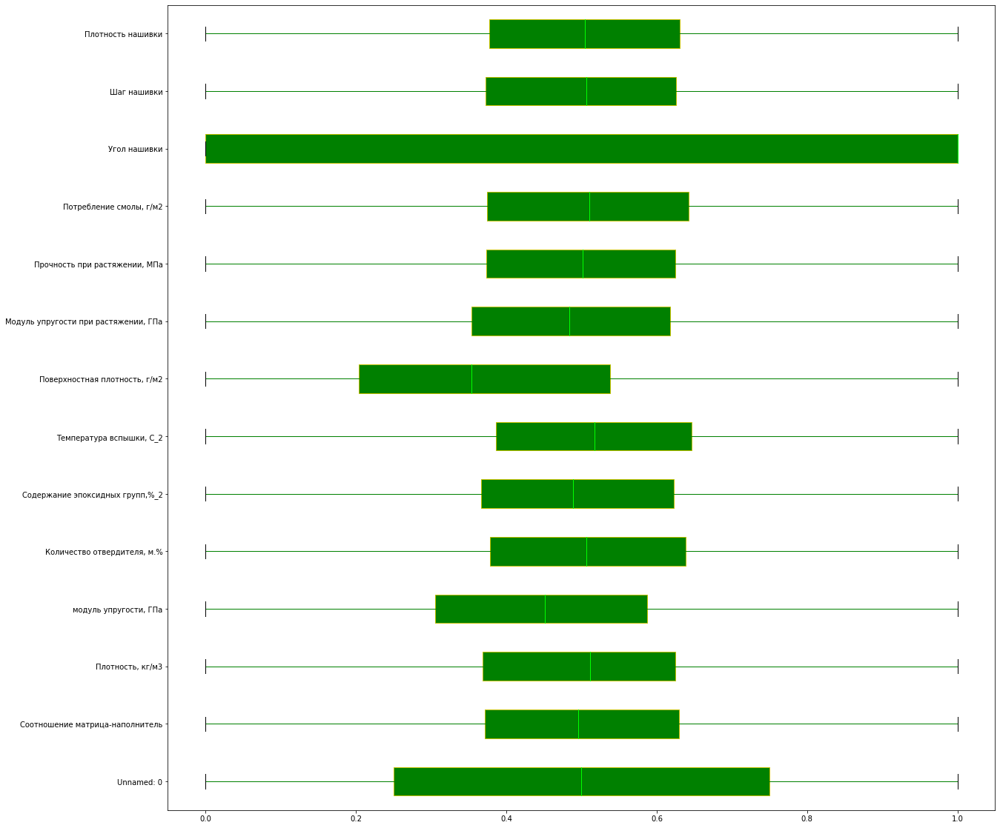

In [27]:
#В третий раз построим на "ящики с усами"
scaler = MinMaxScaler()
scaler.fit(df)
plt.figure(figsize = (20, 20))
#Выводим "ящики"
plt.boxplot(pd.DataFrame(scaler.transform(df)), labels = df.columns,patch_artist = True, meanline = True, vert = False, boxprops = dict(facecolor = 'g', color = 'y'),medianprops = dict(color = 'lime'), whiskerprops = dict(color = "g"), capprops = dict(color = "black"), flierprops = dict(color = "y", markeredgecolor = "maroon"))
plt.show()

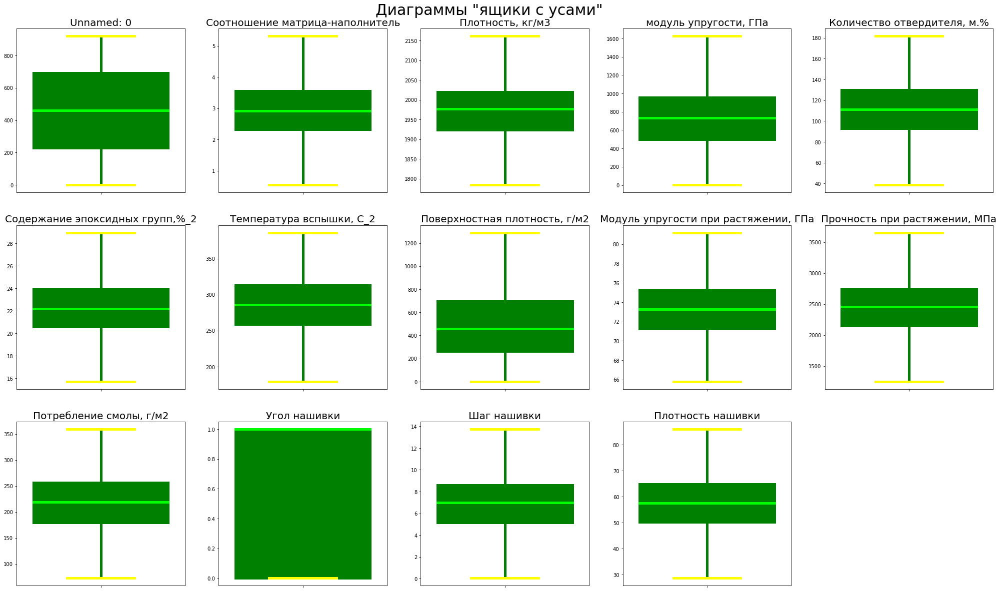

In [28]:
# Ящики с усами (второй вариант)
a = 5 # количество строк
b = 5 # количество столцбцов
c = 1 # инициализация plot counter

plt.figure(figsize = (35,35))
plt.suptitle('Диаграммы "ящики с усами"', y = 0.9 ,
             fontsize = 30)
for col in df.columns:
    plt.subplot(a, b, c)
    #plt.figure(figsize=(7,5))
    sns.boxplot(data = df, y = df[col], fliersize = 15, linewidth = 5, boxprops = dict(facecolor = 'y', color = 'g'), medianprops = dict(color = 'lime'), whiskerprops = dict(color = "g"), capprops = dict(color = "yellow"), flierprops = dict(color = "y", markeredgecolor = "lime"))
    plt.ylabel(None)
    plt.title(col, size = 20)
    #plt.show()
    c += 1

In [29]:
# И снова видим, что выбросы остались в некоторых исходных данных. Это вообще когда-нибудь закончится?о_О???

In [30]:
# Повторяем процедуру с выбросами еще раз. Надеюсь последний
for i in column_list_drop:
    q75, q25 = np.percentile(df.loc[:,i],[75, 25])
    intr_qr = q75 - q25
    max = q75 + (1.5*intr_qr)
    min = q25 - (1.5*intr_qr)
    df.loc[df[i] < min,i] = np.nan
    df.loc[df[i] > max,i] = np.nan

In [31]:
#Еще раз проверим сумму выбросов в каждом столбце
df.isnull().sum()

Unnamed: 0                              0
Соотношение матрица-наполнитель         0
Плотность, кг/м3                        0
модуль упругости, ГПа                   0
Количество отвердителя, м.%             0
Содержание эпоксидных групп,%_2         0
Температура вспышки, С_2                0
Поверхностная плотность, г/м2           0
Модуль упругости при растяжении, ГПа    0
Прочность при растяжении, МПа           0
Потребление смолы, г/м2                 0
Угол нашивки                            0
Шаг нашивки                             0
Плотность нашивки                       0
dtype: int64

In [32]:
#Еще раз удаляем строки с выбросами
df = df.dropna(axis=0)

In [33]:
#И проверочно посмотрим сумму выбросов
df.isnull().sum()

Unnamed: 0                              0
Соотношение матрица-наполнитель         0
Плотность, кг/м3                        0
модуль упругости, ГПа                   0
Количество отвердителя, м.%             0
Содержание эпоксидных групп,%_2         0
Температура вспышки, С_2                0
Поверхностная плотность, г/м2           0
Модуль упругости при растяжении, ГПа    0
Прочность при растяжении, МПа           0
Потребление смолы, г/м2                 0
Угол нашивки                            0
Шаг нашивки                             0
Плотность нашивки                       0
dtype: int64

In [34]:
#Просмотрим на чистый датасет
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 922 entries, 0 to 921
Data columns (total 14 columns):
 #   Column                                Non-Null Count  Dtype  
---  ------                                --------------  -----  
 0   Unnamed: 0                            922 non-null    int64  
 1   Соотношение матрица-наполнитель       922 non-null    float64
 2   Плотность, кг/м3                      922 non-null    float64
 3   модуль упругости, ГПа                 922 non-null    float64
 4   Количество отвердителя, м.%           922 non-null    float64
 5   Содержание эпоксидных групп,%_2       922 non-null    float64
 6   Температура вспышки, С_2              922 non-null    float64
 7   Поверхностная плотность, г/м2         922 non-null    float64
 8   Модуль упругости при растяжении, ГПа  922 non-null    float64
 9   Прочность при растяжении, МПа         922 non-null    float64
 10  Потребление смолы, г/м2               922 non-null    float64
 11  Угол нашивки       

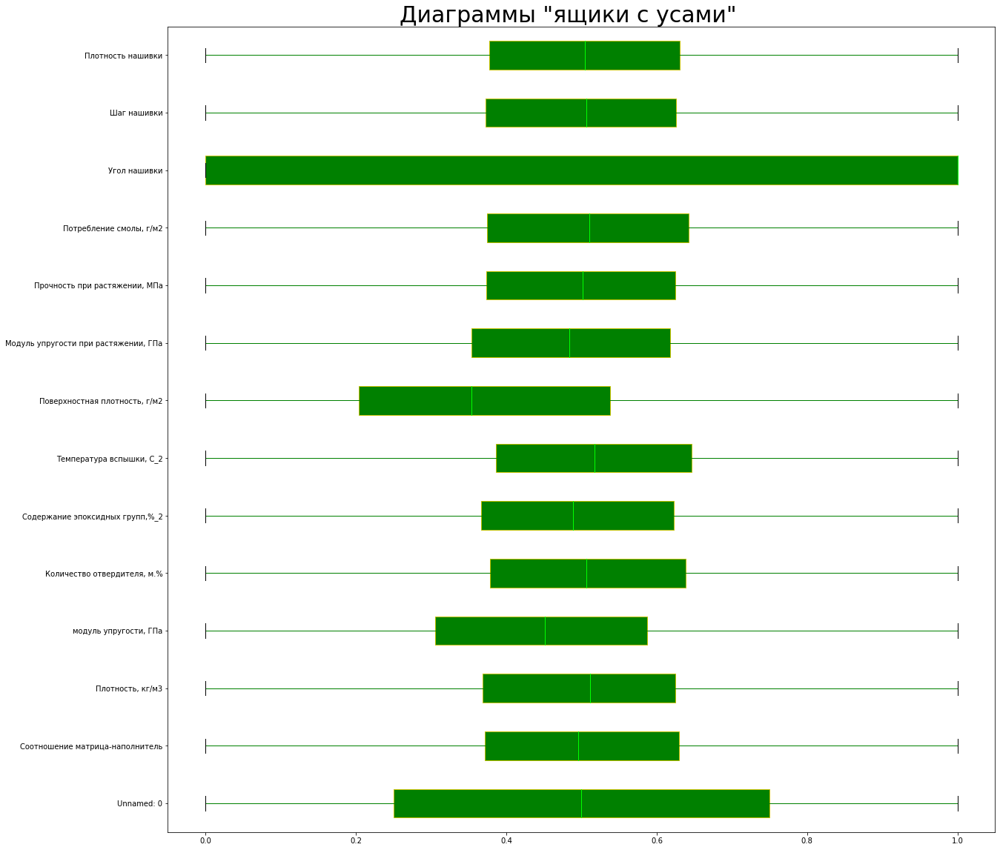

In [35]:
# "Ящики с усами"(боксплоты) (первый вариант)
scaler = MinMaxScaler()
scaler.fit(df)
plt.figure(figsize = (20, 20))
plt.suptitle('Диаграммы "ящики с усами"', y = 0.9 ,
             fontsize = 30)
plt.boxplot(pd.DataFrame(scaler.transform(df)), labels = df.columns,patch_artist = True, meanline = True, vert = False, boxprops = dict(facecolor = 'g', color = 'y'),medianprops = dict(color = 'lime'), whiskerprops = dict(color = "g"), capprops = dict(color = "black"), flierprops = dict(color = "y", markeredgecolor = "maroon"))
plt.show()

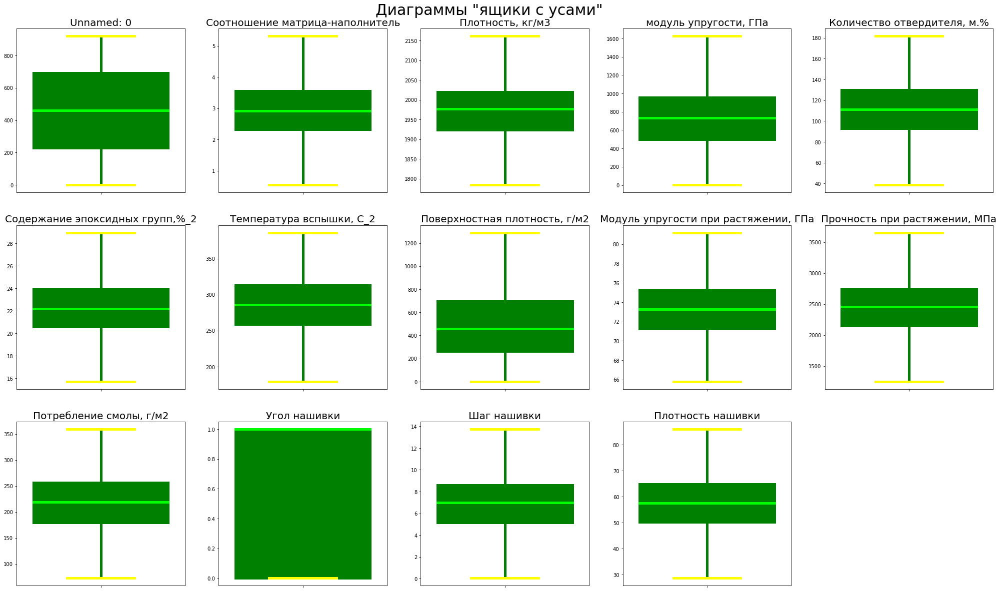

In [36]:
# Ящики с усами (второй вариант)
a = 5 # количество строк
b = 5 # количество столцбцов
c = 1 # инициализация plot counter

plt.figure(figsize = (35,35))
plt.suptitle('Диаграммы "ящики с усами"', y = 0.9 ,
             fontsize = 30)
for col in df.columns:
    plt.subplot(a, b, c)
    #plt.figure(figsize=(7,5))
    sns.boxplot(data = df, y = df[col], fliersize = 15, linewidth = 5, boxprops = dict(facecolor = 'y', color = 'g'), medianprops = dict(color = 'lime'), whiskerprops = dict(color = "g"), capprops = dict(color = "yellow"), flierprops = dict(color = "y", markeredgecolor = "lime"))
    plt.ylabel(None)
    plt.title(col, size = 20)
    #plt.show()
    c += 1

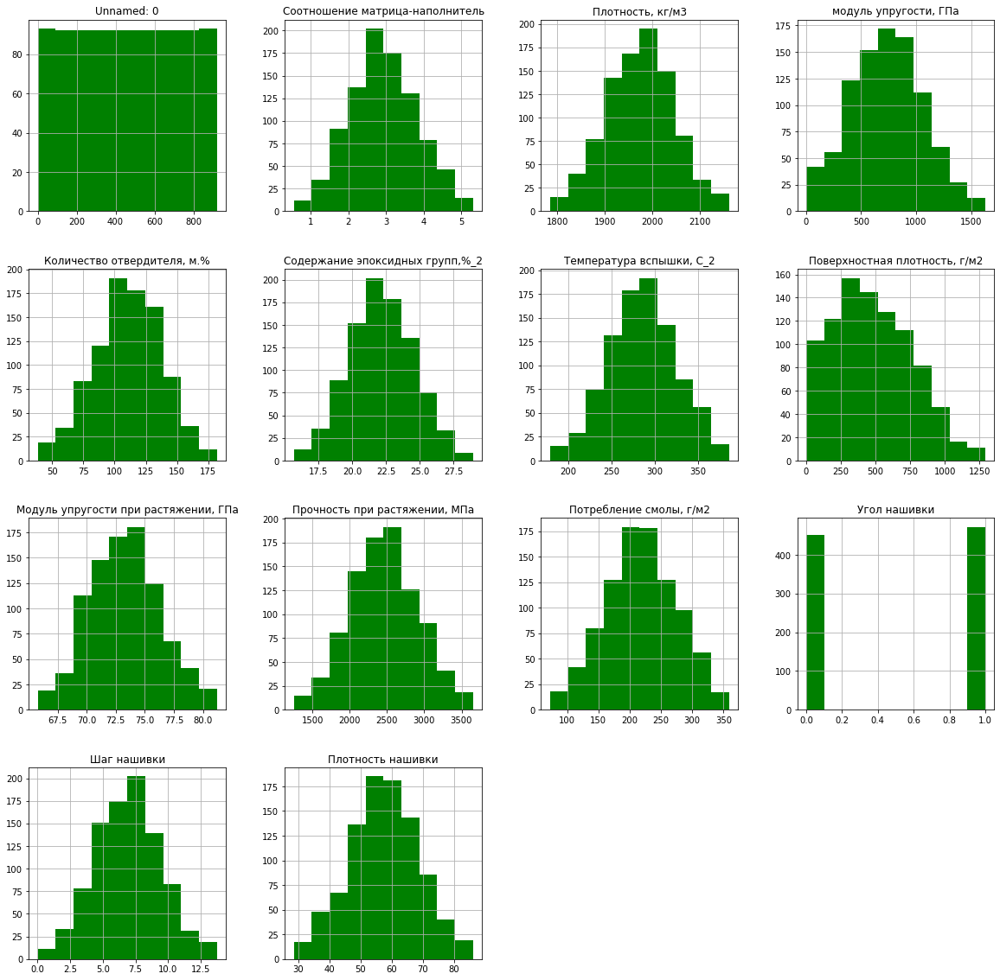

In [37]:
# Построим гистограммы распределения каждой из переменных без нормализации
df.hist(figsize = (20,20), color = "g")
plt.show()

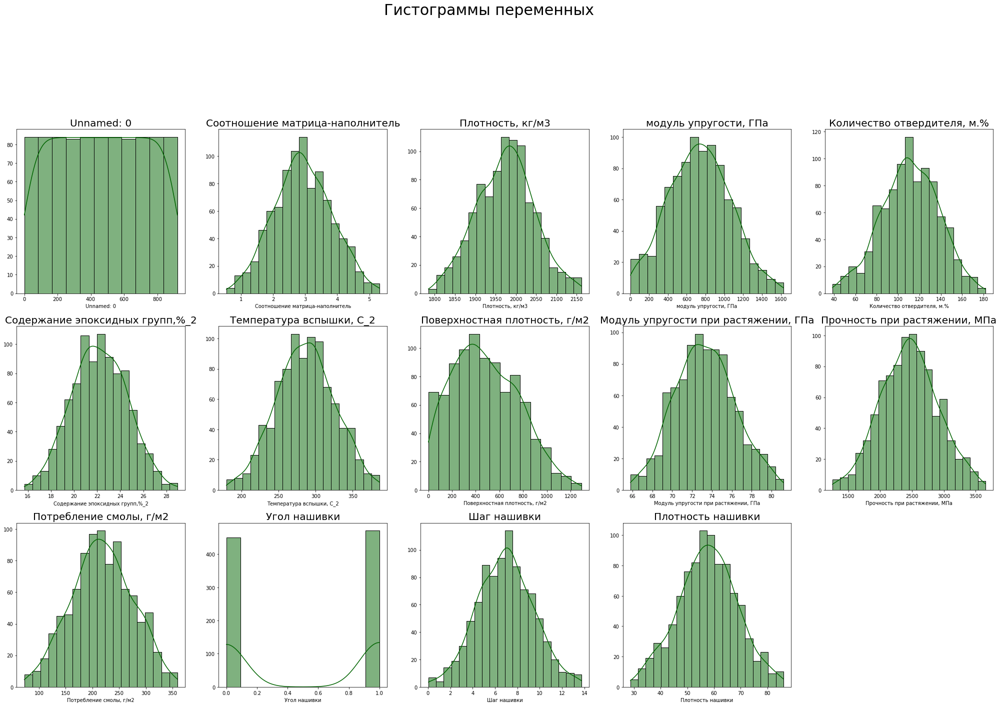

In [38]:
# Гистограмма распределения (второй вариант)
a = 5 # количество строк
b = 5 # количество столцбцов
c = 1 # инициализация plot counter
plt.figure(figsize=(35,35))
plt.suptitle('Гистограммы переменных', fontsize = 30)
for col in df.columns:
    plt.subplot(a, b, c)
    #plt.figure(figsize=(7,5))
    sns.histplot(data = df[col], kde = True, color = "darkgreen")
    plt.ylabel(None)
    plt.title(col, size = 20)
    #plt.show()
    c += 1
#Данные стремятся к нормальному распределению практически везде, кроме угла нашивки, имеющим только 2 значения, с которым мы уже поработали ранее. 

In [39]:
# гистограмма распределения и боксплоты (третий вариант)

for column in df.columns:
    fig = px.histogram(df, x=column, color_discrete_sequence=['green'], nbins=100, marginal="box")
    fig.show()

In [ ]:
for column in df.columns:
    fig = px.box(df, y=column)
    fig.show()

In [ ]:
## Ящики с усами на одном рисунке
plt.figure(figsize=(16,10))
ax = sns.boxplot(data=df)
ax.set_xticklabels(ax.get_xticklabels(),rotation=30);

In [ ]:
#часть кода выше не работает в колабе, поэтому выбросы проверим еще другими способами
for column_name in column_names:
  print(column_name)
    
    #Гистограмма распределения
  gis = df[column_name]
  sns.set_style("whitegrid")
  sns.kdeplot(data = gis, shade = True, palette = 'colorblind', color = "g")
  plt.show()
    
    #Диаграмма "Ящик с усами"
  sns.boxplot(x = gis, color = "g");
  plt.show()
    
    #Значения (мин макс ср)
  print("Минимальное значение: ", end = " ")
  print(np.min(gis))
  print("Максимальное значение: ", end = " ")
  print(np.max(gis))
  print("Среднее значение: ", end = " ")
  print(np.mean(gis))

  print("Медианное значение: ", end = " ")
  print(np.median(gis))
  print("\n\n")

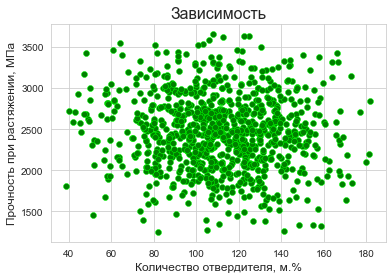

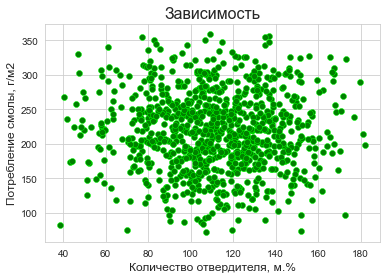

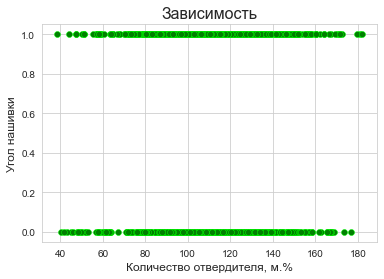

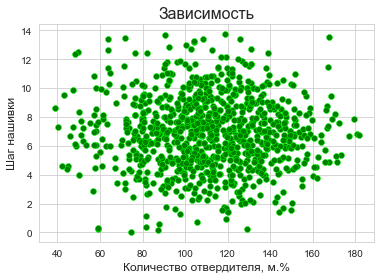

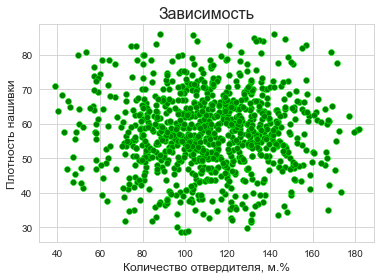

...

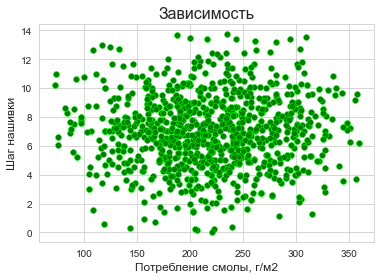

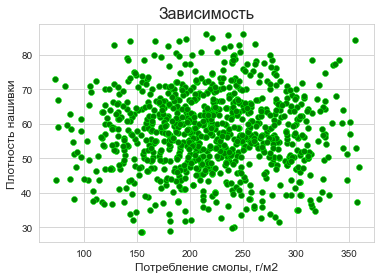

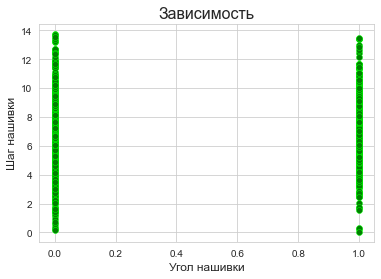

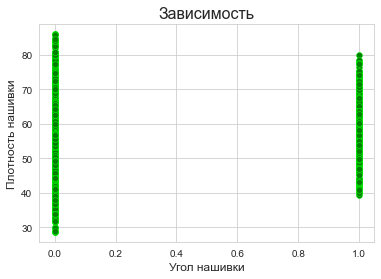

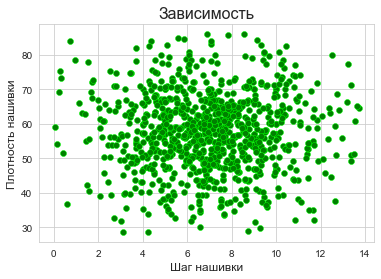

In [43]:
n = 0
while n < len(column_names):
    b = n + 1
    while b < len(column_names):
        sns.set_style('whitegrid')
        plt.title('Зависимость',size = 16)
        plt.xlabel(column_names[n],size = 12)
        plt.ylabel(column_names[b],size = 12)
        sns.scatterplot(x = column_names[n], y = column_names[b], data = df, color = "green", edgecolor = 'lime', palette = 'cubehelix')
        plt.show()
        b += 1
    n += 1

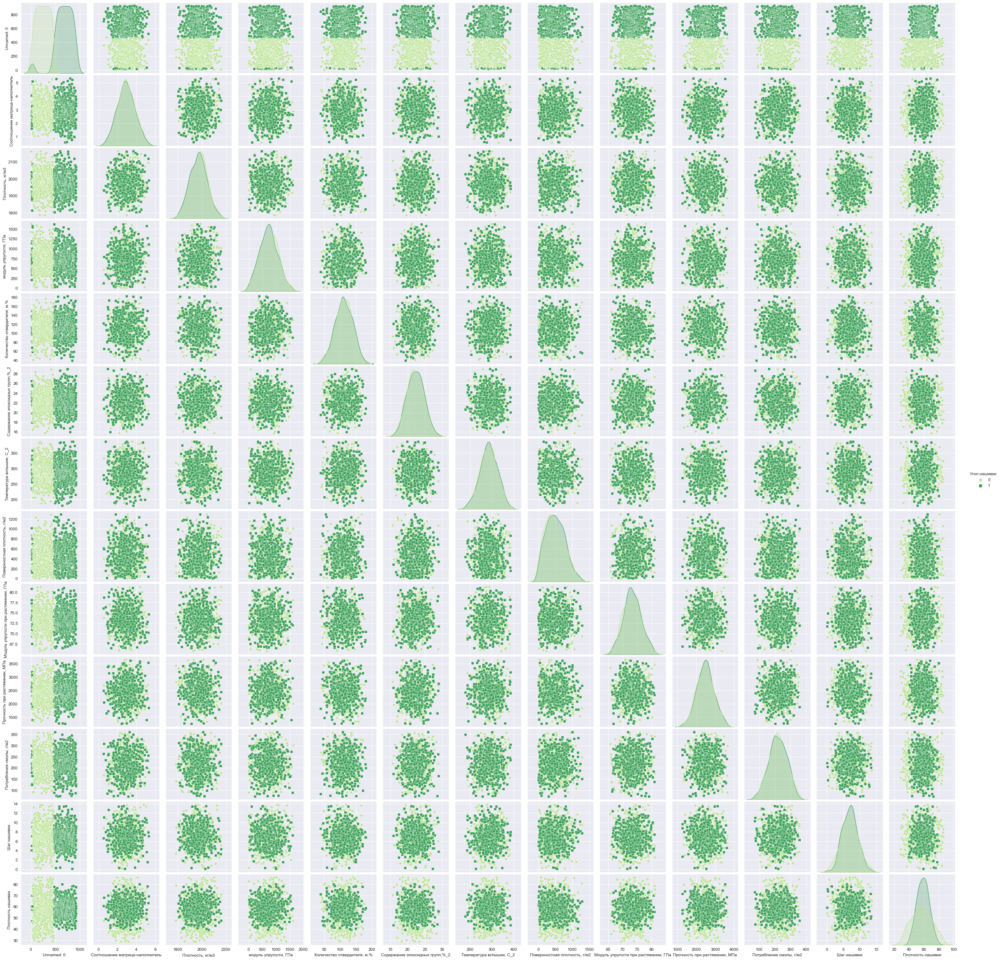

In [44]:
sns.set_style('darkgrid')
sns.pairplot(df, hue = 'Угол нашивки', markers = ["o", "s"], diag_kind = 'auto', palette = 'YlGn')

<function matplotlib.pyplot.show(close=None, block=None)>

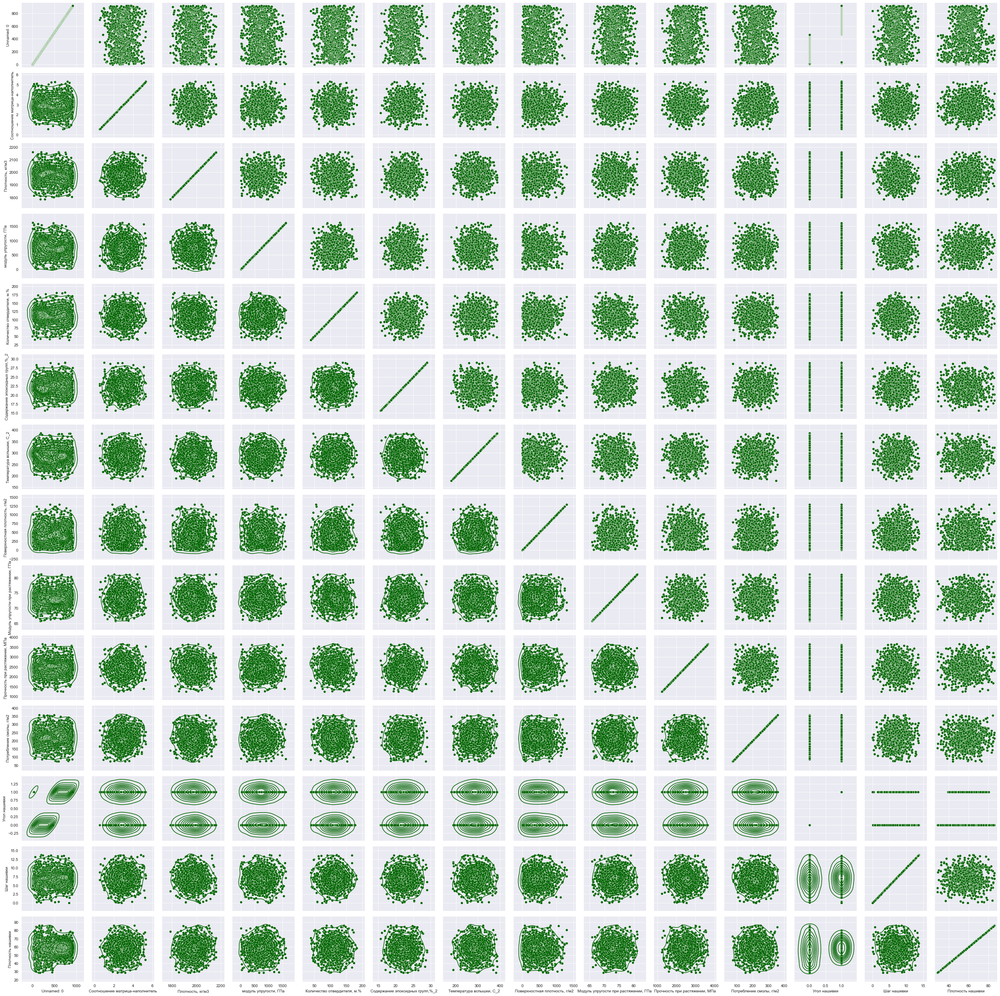

In [45]:
# Попарные графики рассеяния точек - скаттерплоты (второй вариант) 
g = sns.PairGrid(df[df.columns])
g.map(sns.scatterplot, color = 'darkgreen')
g.map_upper(sns.scatterplot, color = 'darkgreen')
g.map_lower(sns.kdeplot, color = 'darkgreen')
plt.show
# Корреляции нет

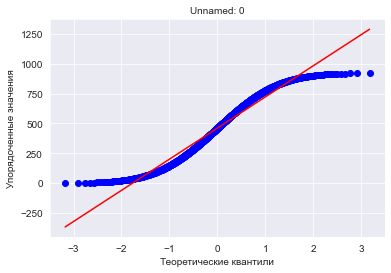

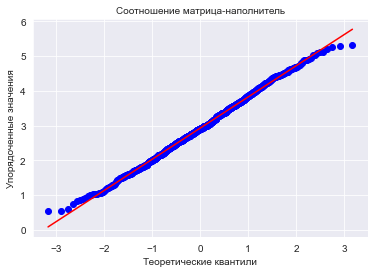

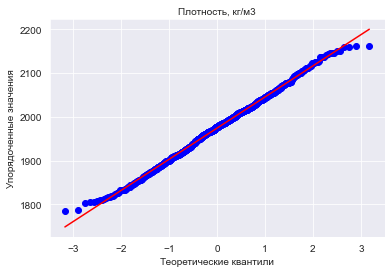

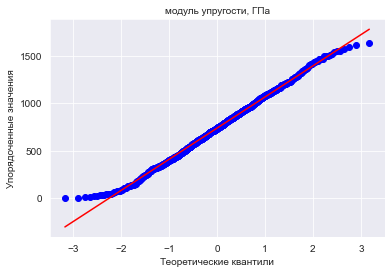

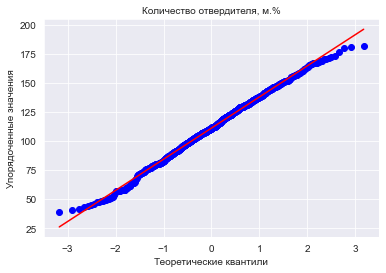

...

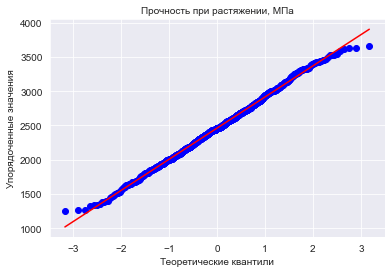

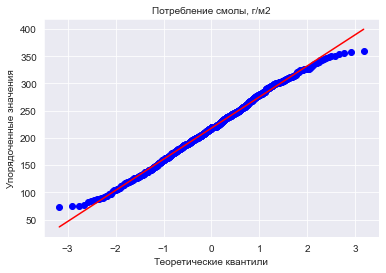

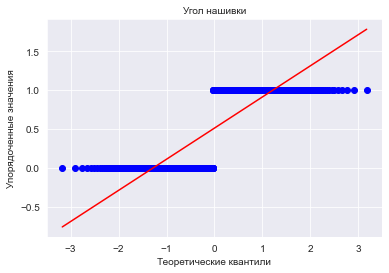

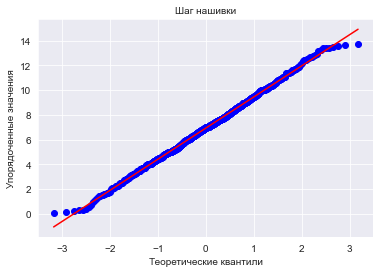

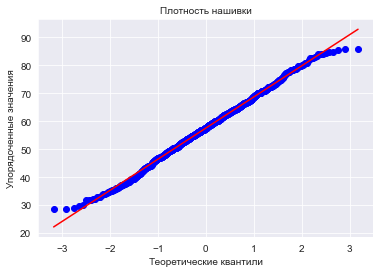

In [46]:
for i in df.columns:
    plt.figure(figsize = (6, 4))
    res = stats.probplot(df[i], plot = plt)
    plt.title(i, fontsize = 10)
    plt.xlabel("Теоретические квантили", fontsize = 10)
    plt.ylabel("Упорядоченные значения", fontsize = 10)
    plt.show()

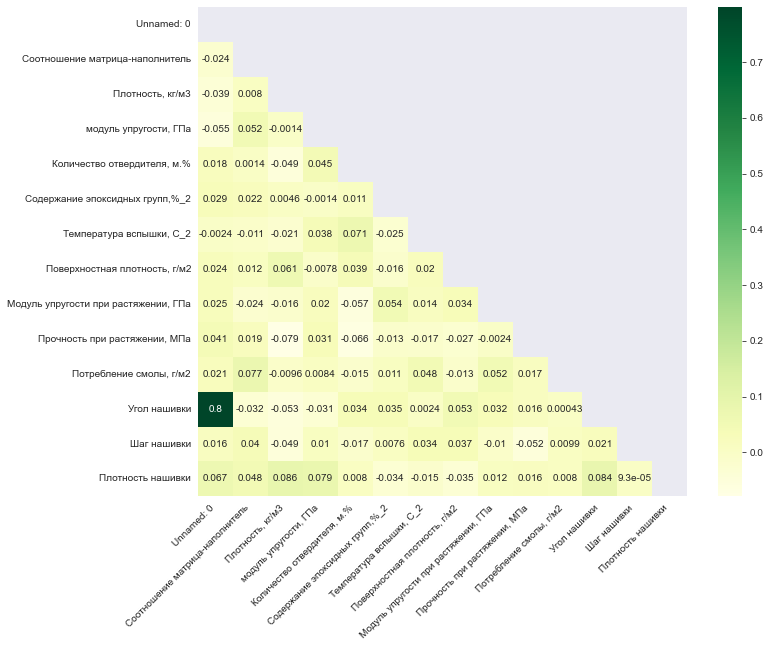

In [47]:
#Визуализация корреляционной матрицы с помощью тепловой карты
mask = np.triu(df.corr())
# Создаем полотно для отображения большого графика
f, ax = plt.subplots(figsize=(11, 9))
# # Визуализируем данные кореляции и создаем цветовую политру
sns.heatmap(df.corr(), mask = mask, annot = True, square = True, cmap = 'YlGn')
plt.xticks(rotation = 45, ha = 'right')
plt.show()

In [48]:
# Уффф, наконец-то, убеждаемся, что выбросов не осталось. В итоге осталось всего 922 строки 
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 922 entries, 0 to 921
Data columns (total 14 columns):
 #   Column                                Non-Null Count  Dtype  
---  ------                                --------------  -----  
 0   Unnamed: 0                            922 non-null    int64  
 1   Соотношение матрица-наполнитель       922 non-null    float64
 2   Плотность, кг/м3                      922 non-null    float64
 3   модуль упругости, ГПа                 922 non-null    float64
 4   Количество отвердителя, м.%           922 non-null    float64
 5   Содержание эпоксидных групп,%_2       922 non-null    float64
 6   Температура вспышки, С_2              922 non-null    float64
 7   Поверхностная плотность, г/м2         922 non-null    float64
 8   Модуль упругости при растяжении, ГПа  922 non-null    float64
 9   Прочность при растяжении, МПа         922 non-null    float64
 10  Потребление смолы, г/м2               922 non-null    float64
 11  Угол нашивки       

In [49]:
#Сохраняем идеальный, без выбросов датасет, чтобы в excel проверить дополнительно
df.to_csv('Itog\Itog.csv', encoding = 'cp1251' )
df.to_excel("Itog\Itog.xlsx")

In [50]:
#Проводим повторный разведочный анализ уже без выбросов

In [51]:
#Выведем корреляции между параметрами
df.corr()

,Unnamed: 0,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2",Угол нашивки,Шаг нашивки,Плотность нашивки
Unnamed: 0,1.000000,-0.023675,-0.039305,-0.054851,0.018401,0.029299,-0.002380,0.023803,0.025344,0.041157,0.020676,0.798601,0.015623,0.067374
Соотношение матрица-наполнитель,-0.023675,1.000000,0.007996,0.051643,0.001353,0.021982,-0.010565,0.011910,-0.024316,0.019141,0.076857,-0.032144,0.039924,0.047835
"Плотность, кг/м3",-0.039305,0.007996,1.000000,-0.001416,-0.048938,0.004568,-0.021256,0.061496,-0.015597,-0.079188,-0.009609,-0.052993,-0.048648,0.086460
"модуль упругости, ГПа",-0.054851,0.051643,-0.001416,1.000000,0.044550,-0.001442,0.037622,-0.007805,0.020063,0.031041,0.008368,-0.031490,0.010238,0.078810
"Количество отвердителя, м.%",0.018401,0.001353,-0.048938,0.044550,1.000000,0.011429,0.070623,0.038762,-0.057026,-0.065711,-0.014827,0.034103,-0.017394,0.007981
"Содержание эпоксидных групп,%_2",0.029299,0.021982,0.004568,-0.001442,0.011429,1.000000,-0.025315,-0.015844,0.053887,-0.013099,0.010808,0.034520,0.007571,-0.034481
"Температура вспышки, С_2",-0.002380,-0.010565,-0.021256,0.037622,0.070623,-0.025315,1.000000,0.020307,0.014168,-0.017263,0.048142,0.002371,0.034395,-0.015014
"Поверхностная плотность, г/м2",0.023803,0.011910,0.061496,-0.007805,0.038762,-0.015844,0.020307,1.000000,0.033526,-0.027320,-0.012606,0.053180,0.036931,-0.034989
"Модуль упругости при растяжении, ГПа",0.025344,-0.024316,-0.015597,0.020063,-0.057026,0.053887,0.014168,0.033526,1.000000,-0.002393,0.051676,0.031910,-0.010193,0.012488
"Прочность при растяжении, МПа",0.041157,0.019141,-0.079188,0.031041,-0.065711,-0.013099,-0.017263,-0.027320,-0.002393,1.000000,0.016753,0.016144,-0.051580,0.016311


In [52]:
# Посмотрим на средние и медианные знчения датасета после выбросов 
mean_and_50 = df.describe()
mean_and_50.loc[['mean', '50%']]
# Убедимся, что после удаления выбросов среднее и медианное значение остались в пределах предыдущих значений

,Unnamed: 0,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2",Угол нашивки,Шаг нашивки,Плотность нашивки
mean,460.5,2.927964,1974.118744,736.119982,111.136066,22.200570,286.181128,482.429070,73.303464,2461.491315,218.048059,0.510846,6.931939,57.562887
50%,460.5,2.907832,1977.321002,736.178435,111.162090,22.177681,286.220763,457.732246,73.247594,2455.974462,218.697660,1.000000,6.972862,57.584225


Приготовим переменные и проверим данные перед нормализацией данных

In [53]:
df_norm = df.copy()

In [54]:
df_norm.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 922 entries, 0 to 921
Data columns (total 14 columns):
 #   Column                                Non-Null Count  Dtype  
---  ------                                --------------  -----  
 0   Unnamed: 0                            922 non-null    int64  
 1   Соотношение матрица-наполнитель       922 non-null    float64
 2   Плотность, кг/м3                      922 non-null    float64
 3   модуль упругости, ГПа                 922 non-null    float64
 4   Количество отвердителя, м.%           922 non-null    float64
 5   Содержание эпоксидных групп,%_2       922 non-null    float64
 6   Температура вспышки, С_2              922 non-null    float64
 7   Поверхностная плотность, г/м2         922 non-null    float64
 8   Модуль упругости при растяжении, ГПа  922 non-null    float64
 9   Прочность при растяжении, МПа         922 non-null    float64
 10  Потребление смолы, г/м2               922 non-null    float64
 11  Угол нашивки       


### Предобработка данных.
Нормализуем данные

У нас в основном количественные признаки, поэтому можно применить нормализацию (приведение в диапазон от 0 до 1) или стандартизацию (приведение к матожиданию 0, стандартному отклонению 1). Т.к. это в том числе учебная работа, то используем и нормализацию, и стандартизацию. 

Этап предобработки данных нужен нам и для введенных данных в будущем приложении, которое явится результатом нашей работы. 

<AxesSubplot:ylabel='Density'>

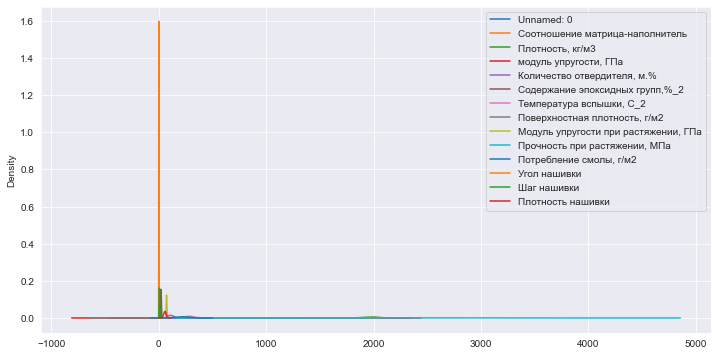

In [55]:
# На данный момент в нашем датасете всего 922 строки. Они все без выбросов, пропущенных значений, все имеют int или float. 
fig, ax = plt.subplots(figsize = (12, 6))
df_norm.plot(kind = 'kde', ax = ax)
# Оценка плотности ядра показывает, что наши данные находятся в разных диапазонах. А в связи с тем, что диапазоны очень разные, данные нужно нормализовать. Можем приступать к нормализации данных.

In [56]:
#Нормализуем данные с помощью MinMaxScaler() 
scaler = preprocessing.MinMaxScaler()
col = df.columns
result = scaler.fit_transform(df)

df_minmax_n = pd.DataFrame(result, columns = col)
df_minmax_n.describe()

,Unnamed: 0,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2",Угол нашивки,Шаг нашивки,Плотность нашивки
count,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000
mean,0.500000,0.499412,0.502904,0.451341,0.506200,0.490578,0.516739,0.373295,0.487343,0.503776,0.507876,0.510846,0.503426,0.503938
std,0.289145,0.187858,0.188395,0.201534,0.186876,0.180548,0.190721,0.217269,0.196366,0.188668,0.199418,0.500154,0.183587,0.193933
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.250000,0.371909,0.368184,0.305188,0.378514,0.366571,0.386228,0.204335,0.353512,0.373447,0.374647,0.000000,0.372844,0.376869
50%,0.500000,0.495189,0.511396,0.451377,0.506382,0.488852,0.516931,0.354161,0.483718,0.501481,0.510143,1.000000,0.506414,0.504310
75%,0.750000,0.629774,0.624719,0.587193,0.638735,0.623046,0.646553,0.538397,0.617568,0.624299,0.642511,1.000000,0.626112,0.630842
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


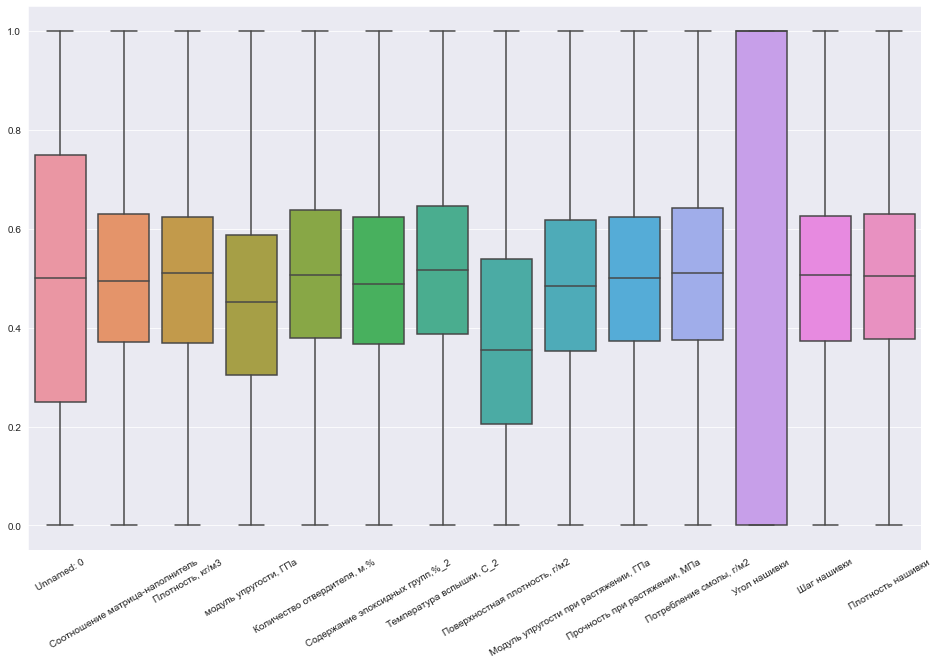

In [57]:
plt.figure(figsize = (16,10))
ax = sns.boxplot(data = df_minmax_n)
ax.set_xticklabels(ax.get_xticklabels(),rotation=30);

<AxesSubplot:ylabel='Density'>

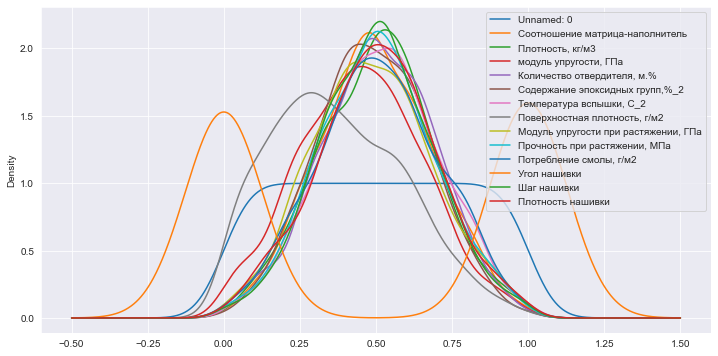

In [58]:
fig, ax = plt.subplots(figsize = (12, 6))
df_minmax_n.plot(kind = 'kde', ax = ax)

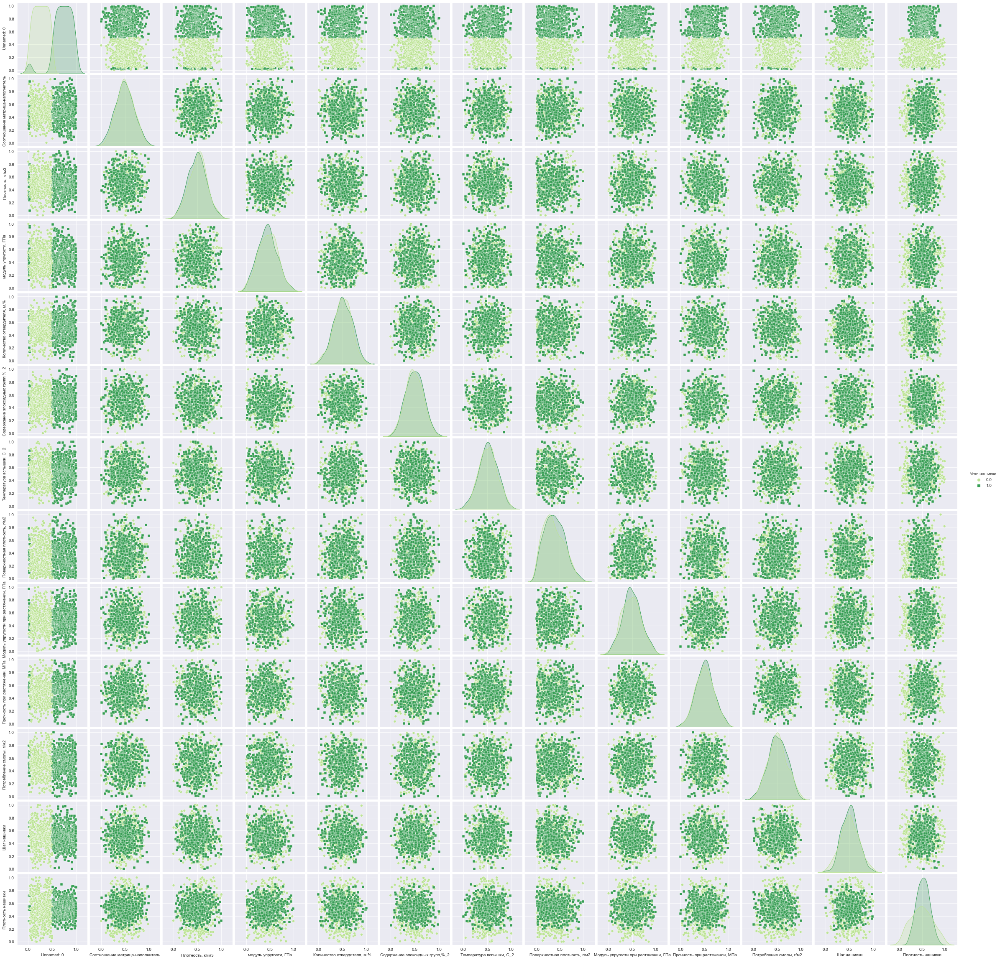

In [59]:
sns.pairplot(df_minmax_n, hue = 'Угол нашивки', markers = ["o", "s"], diag_kind = 'auto', palette = 'YlGn')

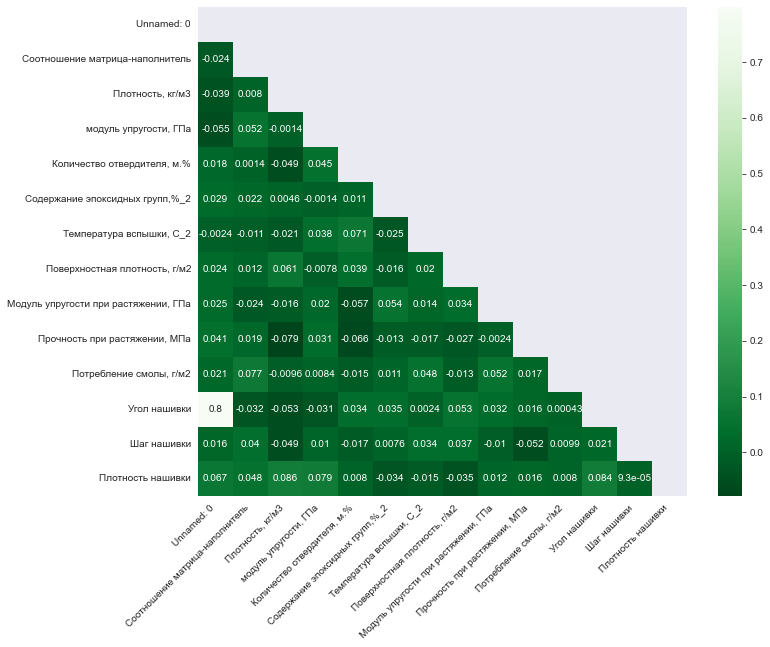

In [60]:
mask = np.triu(df_minmax_n.corr())
f, ax = plt.subplots(figsize = (11, 9))
sns.heatmap(df_minmax_n.corr(), mask = mask, annot = True, square = True, cmap = 'Greens_r')
plt.xticks(rotation = 45, ha = 'right')
plt.show()

In [61]:
#Нормализуем данные с помощью Normalizer()

normalizer = Normalizer()
res = normalizer.fit_transform(df)
df_norm_n = pd.DataFrame(res, columns = df.columns)
df_norm_n

,Unnamed: 0,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2",Угол нашивки,Шаг нашивки,Плотность нашивки
0,0.000000,0.000499,0.545436,0.198490,0.013434,0.006381,0.076473,0.056424,0.018808,0.806064,0.059111,0.000000,0.001075,0.016121
1,0.000268,0.000499,0.545011,0.198335,0.034634,0.005705,0.080543,0.056380,0.018793,0.805435,0.059065,0.000000,0.001342,0.012618
2,0.000537,0.000744,0.544829,0.202097,0.030022,0.005976,0.076388,0.056362,0.018787,0.805167,0.059046,0.000000,0.001342,0.015298
3,0.000809,0.000746,0.539270,0.201687,0.030161,0.006004,0.076742,0.056623,0.018874,0.808906,0.059320,0.000000,0.001348,0.016178
4,0.001089,0.000699,0.519919,0.219672,0.030449,0.006062,0.077475,0.057164,0.019055,0.816626,0.059886,0.000000,0.001361,0.019055
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
917,0.272016,0.000674,0.579061,0.270787,0.025805,0.005969,0.096340,0.062056,0.021681,0.708159,0.037082,0.000297,0.002692,0.013948
918,0.276207,0.001036,0.616828,0.133811,0.043923,0.005897,0.076488,0.105506,0.021940,0.710192,0.035422,0.000301,0.003179,0.016172
919,0.257998,0.000921,0.553720,0.117022,0.031031,0.006726,0.069742,0.207786,0.020981,0.747579,0.066425,0.000281,0.001168,0.018986
920,0.283708,0.001143,0.637357,0.228655,0.043604,0.005935,0.085045,0.197815,0.022833,0.638873,0.060789,0.000308,0.001947,0.017966


<AxesSubplot:ylabel='Density'>

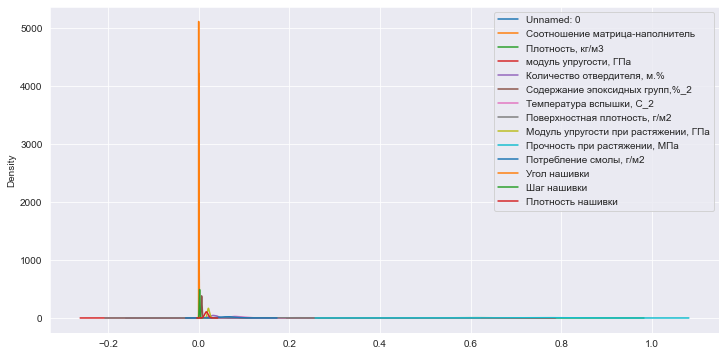

In [62]:
fig, ax = plt.subplots(figsize = (12, 6))
df_norm_n.plot(kind = 'kde', ax = ax)

In [63]:
#Сравним с данными до нормализации
df.head(10)

,Unnamed: 0,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2",Угол нашивки,Шаг нашивки,Плотность нашивки
0,0,1.857143,2030.0,738.736842,50.00,23.750000,284.615385,210.0,70.0,3000.0,220.0,0,4.0,60.0
1,1,1.857143,2030.0,738.736842,129.00,21.250000,300.000000,210.0,70.0,3000.0,220.0,0,5.0,47.0
2,2,2.771331,2030.0,753.000000,111.86,22.267857,284.615385,210.0,70.0,3000.0,220.0,0,5.0,57.0
3,3,2.767918,2000.0,748.000000,111.86,22.267857,284.615385,210.0,70.0,3000.0,220.0,0,5.0,60.0
4,4,2.569620,1910.0,807.000000,111.86,22.267857,284.615385,210.0,70.0,3000.0,220.0,0,5.0,70.0
5,5,2.561475,1900.0,535.000000,111.86,22.267857,284.615385,380.0,75.0,1800.0,120.0,0,7.0,47.0
6,6,3.557018,1930.0,889.000000,129.00,21.250000,300.000000,380.0,75.0,1800.0,120.0,0,7.0,57.0
7,7,3.532338,2100.0,1421.000000,129.00,21.250000,300.000000,1010.0,78.0,2000.0,300.0,0,7.0,60.0
8,8,2.919678,2160.0,933.000000,129.00,21.250000,300.000000,1010.0,78.0,2000.0,300.0,0,7.0,70.0
9,9,2.877358,1990.0,1628.000000,129.00,21.250000,300.000000,1010.0,78.0,2000.0,300.0,0,9.0,47.0


In [64]:
# Проверяем перевод данных из нормализованных в исходные
col = df_minmax_n.columns
result_reverse = scaler.inverse_transform(df_minmax_n)
initial_data = pd.DataFrame(result_reverse, columns = col)
initial_data.head(10)

,Unnamed: 0,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2",Угол нашивки,Шаг нашивки,Плотность нашивки
0,0.0,1.857143,2030.0,738.736842,50.00,23.750000,284.615385,210.0,70.0,3000.0,220.0,0.0,4.0,60.0
1,1.0,1.857143,2030.0,738.736842,129.00,21.250000,300.000000,210.0,70.0,3000.0,220.0,0.0,5.0,47.0
2,2.0,2.771331,2030.0,753.000000,111.86,22.267857,284.615385,210.0,70.0,3000.0,220.0,0.0,5.0,57.0
3,3.0,2.767918,2000.0,748.000000,111.86,22.267857,284.615385,210.0,70.0,3000.0,220.0,0.0,5.0,60.0
4,4.0,2.569620,1910.0,807.000000,111.86,22.267857,284.615385,210.0,70.0,3000.0,220.0,0.0,5.0,70.0
5,5.0,2.561475,1900.0,535.000000,111.86,22.267857,284.615385,380.0,75.0,1800.0,120.0,0.0,7.0,47.0
6,6.0,3.557018,1930.0,889.000000,129.00,21.250000,300.000000,380.0,75.0,1800.0,120.0,0.0,7.0,57.0
7,7.0,3.532338,2100.0,1421.000000,129.00,21.250000,300.000000,1010.0,78.0,2000.0,300.0,0.0,7.0,60.0
8,8.0,2.919678,2160.0,933.000000,129.00,21.250000,300.000000,1010.0,78.0,2000.0,300.0,0.0,7.0,70.0
9,9.0,2.877358,1990.0,1628.000000,129.00,21.250000,300.000000,1010.0,78.0,2000.0,300.0,0.0,9.0,47.0


In [65]:
#Рассмотрим несколько вариантов корреляции между параметрами после нормализации (первый вариант)
df_norm_n[df_norm_n.columns].corr()

,Unnamed: 0,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2",Угол нашивки,Шаг нашивки,Плотность нашивки
Unnamed: 0,1.000000,-0.024313,0.028357,-0.085713,0.030100,0.051446,0.021113,-0.011376,0.047641,-0.191178,0.026305,0.797244,0.035460,0.089432
Соотношение матрица-наполнитель,-0.024313,1.000000,0.280171,0.035787,0.134893,0.219623,0.177884,0.025246,0.261010,-0.249325,0.157185,-0.042057,0.135479,0.171938
"Плотность, кг/м3",0.028357,0.280171,1.000000,-0.036469,0.384277,0.650936,0.557692,0.069777,0.871372,-0.828491,0.308873,-0.011069,0.285142,0.429998
"модуль упругости, ГПа",-0.085713,0.035787,-0.036469,1.000000,0.051490,-0.024971,0.007553,-0.023131,-0.021747,-0.365297,-0.007789,-0.059148,0.004350,0.046465
"Количество отвердителя, м.%",0.030100,0.134893,0.384277,0.051490,1.000000,0.298724,0.305717,0.068327,0.370752,-0.375533,0.138065,0.027012,0.117672,0.195089
"Содержание эпоксидных групп,%_2",0.051446,0.219623,0.650936,-0.024971,0.298724,1.000000,0.396485,0.027019,0.652763,-0.544787,0.238866,0.032763,0.230545,0.266271
"Температура вспышки, С_2",0.021113,0.177884,0.557692,0.007553,0.305717,0.396485,1.000000,0.039367,0.556485,-0.502367,0.241478,0.004924,0.211308,0.248782
"Поверхностная плотность, г/м2",-0.011376,0.025246,0.069777,-0.023131,0.068327,0.027019,0.039367,1.000000,0.057128,-0.309697,0.006138,0.029093,0.066656,-0.018737
"Модуль упругости при растяжении, ГПа",0.047641,0.261010,0.871372,-0.021747,0.370752,0.652763,0.556485,0.057128,1.000000,-0.735849,0.324273,0.020469,0.295766,0.400691
"Прочность при растяжении, МПа",-0.191178,-0.249325,-0.828491,-0.365297,-0.375533,-0.544787,-0.502367,-0.309697,-0.735849,1.000000,-0.276961,-0.148993,-0.277181,-0.379126


In [66]:
#Рассмотрим второй вариант корреляции между параметрами после нормализации (второй вариант)
df_minmax_n[df_minmax_n.columns].corr()

,Unnamed: 0,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2",Угол нашивки,Шаг нашивки,Плотность нашивки
Unnamed: 0,1.000000,-0.023675,-0.039305,-0.054851,0.018401,0.029299,-0.002380,0.023803,0.025344,0.041157,0.020676,0.798601,0.015623,0.067374
Соотношение матрица-наполнитель,-0.023675,1.000000,0.007996,0.051643,0.001353,0.021982,-0.010565,0.011910,-0.024316,0.019141,0.076857,-0.032144,0.039924,0.047835
"Плотность, кг/м3",-0.039305,0.007996,1.000000,-0.001416,-0.048938,0.004568,-0.021256,0.061496,-0.015597,-0.079188,-0.009609,-0.052993,-0.048648,0.086460
"модуль упругости, ГПа",-0.054851,0.051643,-0.001416,1.000000,0.044550,-0.001442,0.037622,-0.007805,0.020063,0.031041,0.008368,-0.031490,0.010238,0.078810
"Количество отвердителя, м.%",0.018401,0.001353,-0.048938,0.044550,1.000000,0.011429,0.070623,0.038762,-0.057026,-0.065711,-0.014827,0.034103,-0.017394,0.007981
"Содержание эпоксидных групп,%_2",0.029299,0.021982,0.004568,-0.001442,0.011429,1.000000,-0.025315,-0.015844,0.053887,-0.013099,0.010808,0.034520,0.007571,-0.034481
"Температура вспышки, С_2",-0.002380,-0.010565,-0.021256,0.037622,0.070623,-0.025315,1.000000,0.020307,0.014168,-0.017263,0.048142,0.002371,0.034395,-0.015014
"Поверхностная плотность, г/м2",0.023803,0.011910,0.061496,-0.007805,0.038762,-0.015844,0.020307,1.000000,0.033526,-0.027320,-0.012606,0.053180,0.036931,-0.034989
"Модуль упругости при растяжении, ГПа",0.025344,-0.024316,-0.015597,0.020063,-0.057026,0.053887,0.014168,0.033526,1.000000,-0.002393,0.051676,0.031910,-0.010193,0.012488
"Прочность при растяжении, МПа",0.041157,0.019141,-0.079188,0.031041,-0.065711,-0.013099,-0.017263,-0.027320,-0.002393,1.000000,0.016753,0.016144,-0.051580,0.016311


In [67]:
df_minmax_n

,Unnamed: 0,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2",Угол нашивки,Шаг нашивки,Плотность нашивки
0,0.000000,0.274768,0.651097,0.452951,0.079153,0.607435,0.509164,0.162230,0.272962,0.727777,0.514688,0.0,0.289334,0.546433
1,0.001086,0.274768,0.651097,0.452951,0.630983,0.418887,0.583596,0.162230,0.272962,0.727777,0.514688,0.0,0.362355,0.319758
2,0.002172,0.466552,0.651097,0.461725,0.511257,0.495653,0.509164,0.162230,0.272962,0.727777,0.514688,0.0,0.362355,0.494123
3,0.003257,0.465836,0.571539,0.458649,0.511257,0.495653,0.509164,0.162230,0.272962,0.727777,0.514688,0.0,0.362355,0.546433
4,0.004343,0.424236,0.332865,0.494944,0.511257,0.495653,0.509164,0.162230,0.272962,0.727777,0.514688,0.0,0.362355,0.720799
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
917,0.995657,0.361662,0.444480,0.560064,0.337550,0.333908,0.703458,0.161609,0.473553,0.472912,0.183151,1.0,0.660014,0.320103
918,0.996743,0.607674,0.704373,0.272088,0.749605,0.294428,0.362087,0.271207,0.462512,0.461722,0.157752,1.0,0.768759,0.437468
919,0.997828,0.573391,0.498274,0.254927,0.501991,0.623085,0.334063,0.572959,0.580201,0.587558,0.572648,1.0,0.301102,0.679468
920,0.998914,0.662497,0.748688,0.454635,0.717585,0.267818,0.466417,0.496511,0.535317,0.341643,0.434855,1.0,0.458245,0.516112


In [68]:
df_norm_n

,Unnamed: 0,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2",Угол нашивки,Шаг нашивки,Плотность нашивки
0,0.000000,0.000499,0.545436,0.198490,0.013434,0.006381,0.076473,0.056424,0.018808,0.806064,0.059111,0.000000,0.001075,0.016121
1,0.000268,0.000499,0.545011,0.198335,0.034634,0.005705,0.080543,0.056380,0.018793,0.805435,0.059065,0.000000,0.001342,0.012618
2,0.000537,0.000744,0.544829,0.202097,0.030022,0.005976,0.076388,0.056362,0.018787,0.805167,0.059046,0.000000,0.001342,0.015298
3,0.000809,0.000746,0.539270,0.201687,0.030161,0.006004,0.076742,0.056623,0.018874,0.808906,0.059320,0.000000,0.001348,0.016178
4,0.001089,0.000699,0.519919,0.219672,0.030449,0.006062,0.077475,0.057164,0.019055,0.816626,0.059886,0.000000,0.001361,0.019055
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
917,0.272016,0.000674,0.579061,0.270787,0.025805,0.005969,0.096340,0.062056,0.021681,0.708159,0.037082,0.000297,0.002692,0.013948
918,0.276207,0.001036,0.616828,0.133811,0.043923,0.005897,0.076488,0.105506,0.021940,0.710192,0.035422,0.000301,0.003179,0.016172
919,0.257998,0.000921,0.553720,0.117022,0.031031,0.006726,0.069742,0.207786,0.020981,0.747579,0.066425,0.000281,0.001168,0.018986
920,0.283708,0.001143,0.637357,0.228655,0.043604,0.005935,0.085045,0.197815,0.022833,0.638873,0.060789,0.000308,0.001947,0.017966


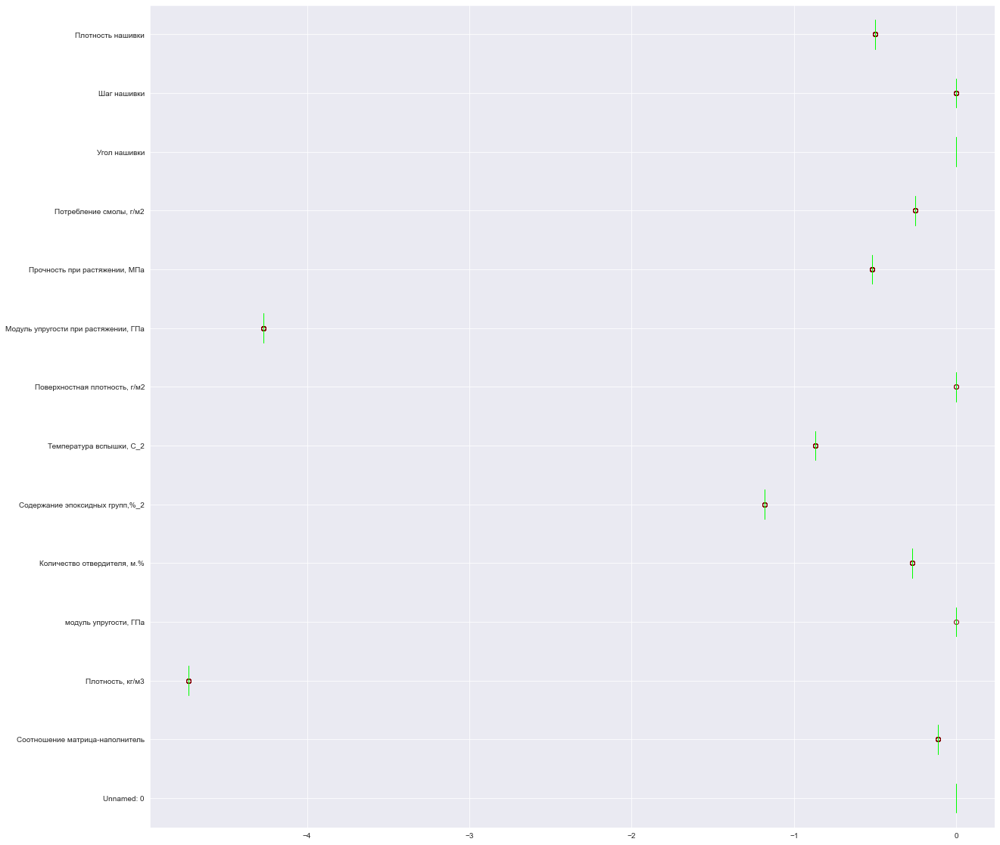

In [69]:
#Построим на "ящики с усами"
scaler = MinMaxScaler()
scaler.fit(df)
plt.figure(figsize=(20, 20))
#Выводим "ящики"
plt.boxplot(pd.DataFrame(scaler.transform(df_norm_n)), labels = df_norm_n.columns, patch_artist = True, meanline = True, vert = False, boxprops = dict(facecolor = 'g', color = 'y'),medianprops = dict(color = 'lime'), whiskerprops = dict(color = "g"), capprops = dict(color="black"), flierprops = dict(color = "y", markeredgecolor = "maroon"))
plt.show()


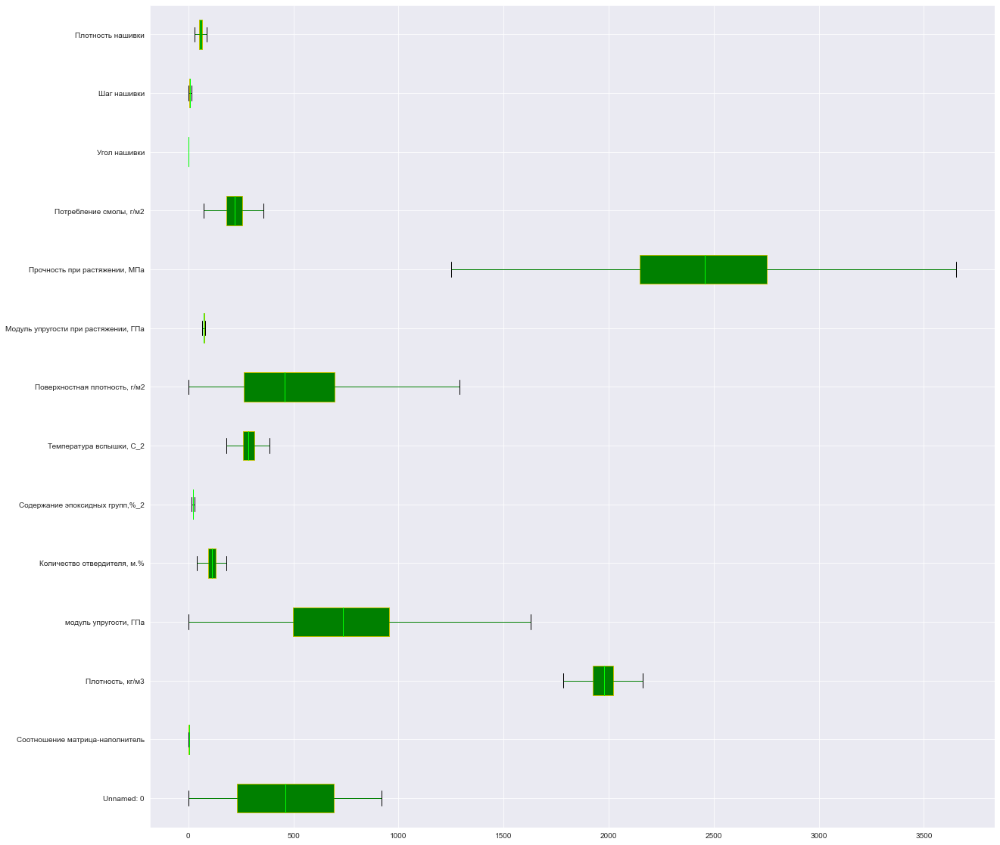

In [70]:
#Попытаемся посмотреть на "ящики с усами"
scaler = MinMaxScaler()
scaler.fit(df_minmax_n)
plt.figure(figsize = (20, 20))
#Выводим "ящики"
plt.boxplot(pd.DataFrame(scaler.transform(df)), labels = df_minmax_n.columns, patch_artist = True, meanline = True, vert = False, boxprops = dict(facecolor = 'g', color = 'y'),medianprops = dict(color = 'lime'), whiskerprops = dict(color = "g"), capprops = dict(color = "black"), flierprops = dict(color = "y", markeredgecolor = "maroon"))
plt.show()


In [71]:
# Визуализация графиков показывает, что нормализация при помощи "Normalizer" дает нам большое количество выбросов

### Стандартизируем данные

In [72]:
X1 = df_minmax_n.copy()
X2 = df_norm_n.copy()

In [73]:
df_std_X1 = preprocessing.StandardScaler().fit(X1)
df_standart_X1 = df_std_X1.transform(X1)
df_standart_1 = pd.DataFrame(df_standart_X1)

<AxesSubplot:ylabel='Density'>

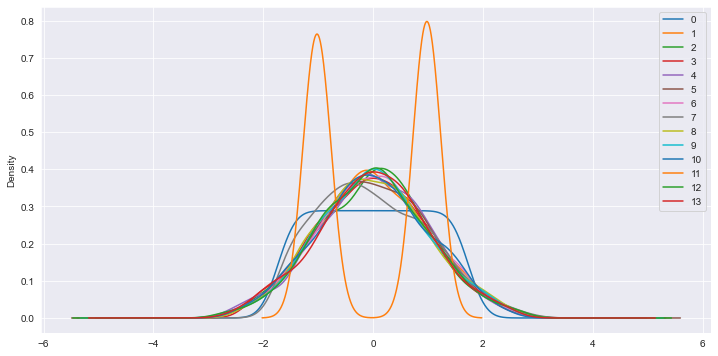

In [74]:
fig, ax = plt.subplots(figsize = (12, 6))
df_standart_1.plot(kind = 'kde', ax = ax)

In [75]:
df_standart_1

,0,1,2,3,4,5,6,7,8,9,10,11,12,13
0,-1.730173,-1.196467,0.787037,0.007992,-2.286425,0.647585,-0.039740,-0.971971,-1.092335,1.187925,0.034181,-1.021932,-1.166792,0.219240
1,-1.726416,-1.196467,0.787037,0.007992,0.668092,-0.397291,0.350738,-0.971971,-1.092335,1.187925,0.034181,-1.021932,-0.768833,-0.950227
2,-1.722659,-0.175012,0.787037,0.051553,0.027074,0.028123,-0.039740,-0.971971,-1.092335,1.187925,0.034181,-1.021932,-0.768833,-0.050637
3,-1.718902,-0.178825,0.364514,0.036283,0.027074,0.028123,-0.039740,-0.971971,-1.092335,1.187925,0.034181,-1.021932,-0.768833,0.219240
4,-1.715145,-0.400390,-0.903054,0.216474,0.027074,0.028123,-0.039740,-0.971971,-1.092335,1.187925,0.034181,-1.021932,-0.768833,1.118831
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
917,1.715145,-0.733662,-0.310284,0.539767,-0.902956,-0.868217,0.979545,-0.974830,-0.070267,-0.163679,-1.629244,0.978538,0.853400,-0.948449
918,1.718902,0.576611,1.069974,-0.889924,1.303201,-1.087006,-0.811326,-0.470122,-0.126524,-0.223019,-1.756683,0.978538,1.446055,-0.342933
919,1.722659,0.394018,-0.024589,-0.975122,-0.022536,0.734311,-0.958342,0.919470,0.473140,0.444312,0.324984,0.978538,-1.102660,0.905599
920,1.726416,0.868603,1.305328,0.016356,1.131763,-1.234469,-0.263996,0.567419,0.244441,-0.859827,-0.366368,0.978538,-0.246233,0.062808


In [76]:
df_std_X2 = preprocessing.StandardScaler().fit(X2)
df_standart_X2 = df_std_X2.transform(X2)
df_standart_2 = pd.DataFrame(df_standart_X2)

<AxesSubplot:ylabel='Density'>

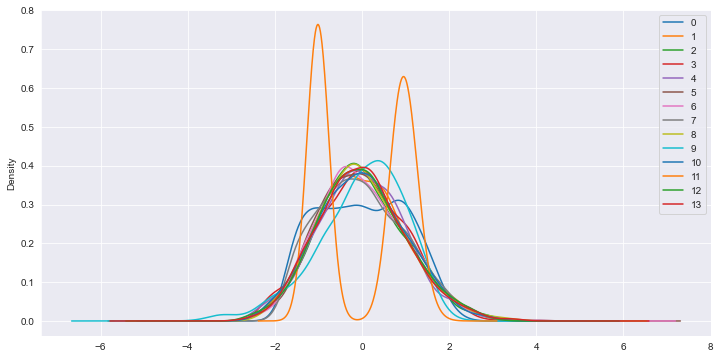

In [77]:
fig, ax = plt.subplots(figsize = (12, 6))
df_standart_2.plot(kind = 'kde', ax=ax)

In [78]:
df_standart_2

,0,1,2,3,4,5,6,7,8,9,10,11,12,13
0,-1.724444,-1.329972,-0.700777,-0.199459,-2.242397,-0.250592,-0.609386,-1.045715,-1.276054,1.205017,-0.326616,-1.011172,-1.253970,-0.282841
1,-1.721052,-1.331354,-0.707561,-0.201094,0.159850,-0.931277,-0.333360,-1.046246,-1.282131,1.196004,-0.329148,-1.011172,-0.917959,-1.223240
2,-1.717662,-0.460974,-0.710455,-0.161372,-0.362737,-0.658186,-0.615158,-1.046473,-1.284723,1.192159,-0.330227,-1.011172,-0.918520,-0.503822
3,-1.714223,-0.451979,-0.799074,-0.165697,-0.346938,-0.630247,-0.591104,-1.043314,-1.248592,1.245744,-0.315178,-1.011172,-0.910696,-0.267581
4,-1.710686,-0.618305,-1.107575,0.024205,-0.314317,-0.572557,-0.541437,-1.036791,-1.173988,1.356385,-0.284104,-1.011172,-0.894541,0.504676
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
917,1.712483,-0.709564,-0.164740,0.563907,-0.840584,-0.665383,0.737759,-0.977744,-0.086138,-0.198020,-1.535684,0.973430,0.776909,-0.866358
918,1.765433,0.577121,0.437335,-0.882390,1.212475,-0.738006,-0.608349,-0.453314,0.021061,-0.168883,-1.626759,1.001810,1.387791,-0.269097
919,1.535370,0.168035,-0.568720,-1.059659,-0.248403,0.096150,-1.065788,0.781166,-0.376314,0.366896,0.074761,0.867062,-1.136656,0.486316
920,1.860216,0.954882,0.764596,0.119051,1.176352,-0.699560,-0.028154,0.660817,0.390817,-1.190931,-0.234515,1.051986,-0.159078,0.212539


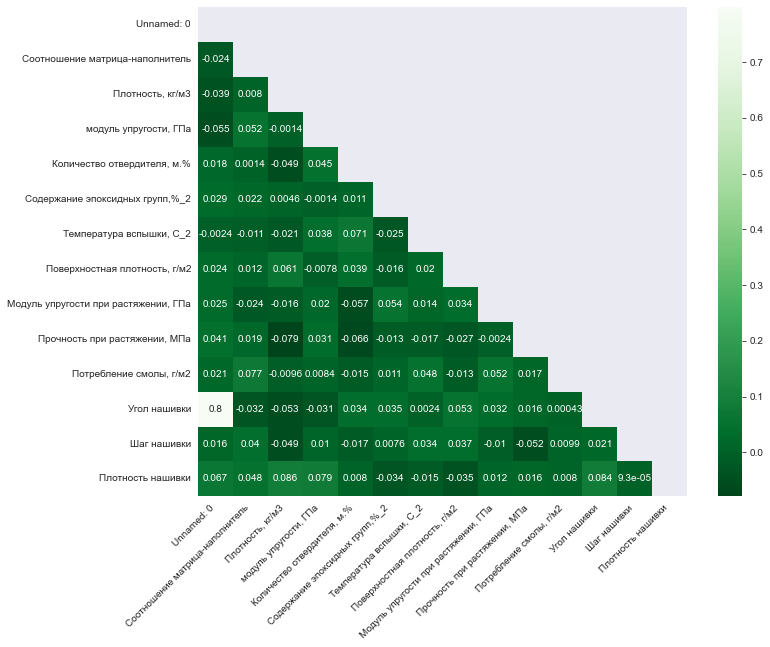

In [79]:
mask = np.triu(X1.corr())
f, ax = plt.subplots(figsize=(11, 9))
sns.heatmap(X1.corr(), mask=mask, annot=True, square=True, cmap='Greens_r')
plt.xticks(rotation=45, ha='right')
plt.show()

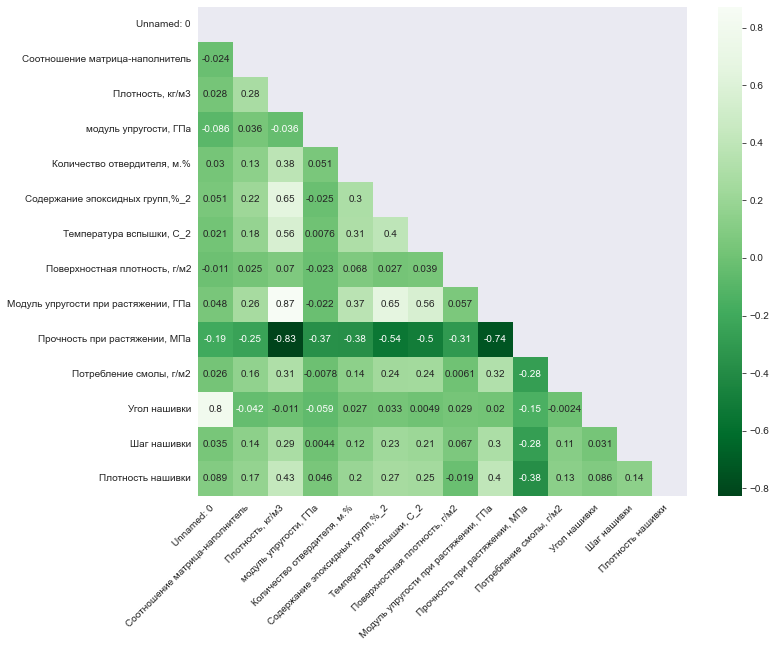

In [80]:
mask = np.triu(X2.corr())
f, ax = plt.subplots(figsize=(11, 9))
sns.heatmap(X2.corr(), mask=mask, annot=True, square=True, cmap='Greens_r')
plt.xticks(rotation=45, ha='right')
plt.show()

In [81]:
df_norm_n.describe()

,Unnamed: 0,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2",Угол нашивки,Шаг нашивки,Плотность нашивки
count,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000
mean,0.136481,0.000874,0.589395,0.217380,0.033223,0.006630,0.085460,0.143065,0.021889,0.721977,0.065062,0.000151,0.002074,0.017175
std,0.079188,0.000282,0.062762,0.094759,0.008830,0.000994,0.014756,0.082898,0.002416,0.069819,0.018230,0.000150,0.000797,0.003727
min,0.000000,0.000162,0.443526,0.000703,0.011338,0.004102,0.049258,0.000230,0.016004,0.463108,0.021501,0.000000,0.000011,0.007152
25%,0.067487,0.000676,0.544650,0.149169,0.027253,0.005917,0.075299,0.079085,0.020174,0.680318,0.051933,0.000000,0.001527,0.014627
50%,0.134841,0.000860,0.584696,0.217972,0.033005,0.006579,0.084087,0.138037,0.021709,0.730982,0.064760,0.000239,0.002040,0.017102
75%,0.203894,0.001053,0.630216,0.285099,0.039153,0.007259,0.095598,0.201477,0.023481,0.773008,0.077307,0.000294,0.002580,0.019520
max,0.321947,0.001803,0.802854,0.525070,0.062859,0.010626,0.144122,0.414125,0.030444,0.875356,0.122368,0.000409,0.004517,0.030187


In [82]:
df_minmax_n.describe()

,Unnamed: 0,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2",Угол нашивки,Шаг нашивки,Плотность нашивки
count,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000
mean,0.500000,0.499412,0.502904,0.451341,0.506200,0.490578,0.516739,0.373295,0.487343,0.503776,0.507876,0.510846,0.503426,0.503938
std,0.289145,0.187858,0.188395,0.201534,0.186876,0.180548,0.190721,0.217269,0.196366,0.188668,0.199418,0.500154,0.183587,0.193933
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.250000,0.371909,0.368184,0.305188,0.378514,0.366571,0.386228,0.204335,0.353512,0.373447,0.374647,0.000000,0.372844,0.376869
50%,0.500000,0.495189,0.511396,0.451377,0.506382,0.488852,0.516931,0.354161,0.483718,0.501481,0.510143,1.000000,0.506414,0.504310
75%,0.750000,0.629774,0.624719,0.587193,0.638735,0.623046,0.646553,0.538397,0.617568,0.624299,0.642511,1.000000,0.626112,0.630842
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


### Разработка и обучение нескольких моделей для прогноза прочности при растяжении

In [83]:
'''Данные в нашем итоговом датасете в основном непрерывные и на ум приходит сразу решение данной задачи с использованием регрессионных моделей.
Но попарные графики рассеивания точек и тепловая карта не дают нам реальной взаимосвязи и возможности прямого прогнозирования, 
поэтому будем использовать и категориальные подходы к прогнозированию (например, попробуем метод ближайших соседей) 
или обучение со скрытыми слоями, чтобы выявить дополнительные взаимосвязи.

Задача ВКР на этом этапе звучит так: "При построении моделей провести поиск гиперпараметров модели с помощью поиска по сетке с перекрестной проверкой, количество блоков равно 10.'''

'Данные в нашем итоговом датасете в основном непрерывные и на ум приходит сразу решение данной задачи с использованием регрессионных моделей.\nНо попарные графики рассеивания точек и тепловая карта не дают нам реальной взаимосвязи и возможности прямого прогнозирования, \nпоэтому будем использовать и категориальные подходы к прогнозированию (например, попробуем метод ближайших соседей) \nили обучение со скрытыми слоями, чтобы выявить дополнительные взаимосвязи.\n\nЗадача ВКР на этом этапе звучит так: "При построении моделей провести поиск гиперпараметров модели с помощью поиска по сетке с перекрестной проверкой, количество блоков равно 10.'

Сформируем выборки и посмотрим, что получилось

In [84]:
# Прогнозируем прочность при растяжении

После всех подготовительных работ переходим к процессу создания, обучения моделей. Мы будем использовать в Python библиотеку Scikit-Learn.
В качестве базового уровня предскажем медианное значение цели на обучающем наборе для всех примеров в тестовом наборе. В качестве метрики возьмём среднюю абсолютную ошибку (mae) в прогнозах. Для обучения используем 70 % данных, а для тестирования — 30 %.

In [85]:
#разбиваем на тестовую, тренировочную выборки, выделяя предикторы и целевые переменные
x_train_1, x_test_1, y_train_1, y_test_1 = train_test_split(
    df_norm_n.loc[:, df_norm_n.columns != 'Прочность при растяжении, МПа'],
    df[['Прочность при растяжении, МПа']],
       test_size = 0.3,
    random_state = 42)

In [86]:
# Проверка правильности разбивки
df_norm_n.shape[0] - x_train_1.shape[0] - x_test_1.shape[0]

0

In [87]:
x_train_1.head()

,Unnamed: 0,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Потребление смолы, г/м2",Угол нашивки,Шаг нашивки,Плотность нашивки
481,0.138440,0.000523,0.583394,0.130876,0.020795,0.006194,0.070762,0.184291,0.020024,0.072334,0.000288,0.002263,0.015413
650,0.196184,0.000422,0.605304,0.227991,0.026722,0.007203,0.074110,0.079766,0.024354,0.055735,0.000302,0.001324,0.017954
483,0.140997,0.000574,0.579585,0.168815,0.042968,0.007003,0.095586,0.131480,0.020985,0.041073,0.000292,0.002227,0.018740
355,0.095834,0.000907,0.543384,0.304721,0.024357,0.006580,0.070163,0.159182,0.018442,0.049917,0.000000,0.001766,0.012482
850,0.264153,0.000553,0.574561,0.254615,0.032952,0.007252,0.086400,0.092201,0.022685,0.083270,0.000311,0.002667,0.016569


In [88]:
y_train_1

,"Прочность при растяжении, МПа"
481,2641.571967
650,2404.068921
483,2619.854215
355,2793.783901
850,2298.985700
...,...
106,1994.674603
270,2419.732206
860,2758.414767
435,2347.135204


In [89]:
y_test_1

,"Прочность при растяжении, МПа"
319,2167.533030
377,2705.819718
538,2952.839631
296,2305.241225
531,1399.118555
...,...
420,3305.286922
133,2085.866383
490,2461.609016
558,2616.114331


In [90]:
y_train_1.shape

(645, 1)

In [91]:
#Функция для сравнения результатов предсказаний с моделью, выдающей среднее значение по тестовой выборке
def mean_model(y_test_1):
    return [np.mean(y_test_1) for _ in range(len(y_test_1))]
y_1_pred_mean = mean_model(y_test_1)

In [92]:
#Проверка различных моделей при стандартных параметрах
# Метод опорных векторов - 1 

In [93]:
svr = make_pipeline(StandardScaler(), SVR(kernel = 'rbf', C = 500.0, epsilon = 1.0))
#обучаем модель
svr.fit(x_train_1, np.ravel(y_train_1))
#вычисляем коэффициент детерминации
y_pred_svr=svr.predict(x_test_1)
mae_svr = mean_absolute_error(y_pred_svr, y_test_1)
mse_svr_elast = mean_squared_error(y_test_1,y_pred_svr)
print('Support Vector Regression Results Train:') 
print("Test score: {:.2f}".format(svr.score(x_train_1, y_train_1))) # Скор для тренировочной выборки
print('Support Vector Regression Results:')
print('SVR_MAE:', round(mean_absolute_error(y_test_1, y_pred_svr)))
print('SVR_MAPE: {:.2f}'.format(mean_absolute_percentage_error(y_test_1, y_pred_svr)))
print('SVR_MSE: {:.2f}'.format(mse_svr_elast))
print("SVR_RMSE: {:.2f}".format (np.sqrt(mse_svr_elast)))
print("Test score: {:.2f}".format(svr.score(x_test_1, y_test_1))) # Скор для тестовой выборки

Support Vector Regression Results Train:
Test score: 0.99
Support Vector Regression Results:
SVR_MAE: 76
SVR_MAPE: 0.03
SVR_MSE: 11099.84
SVR_RMSE: 105.36
Test score: 0.95


In [94]:
#Результаты модели, выдающей среднее значение
mse_lin_elast_mean = mean_squared_error(y_test_1, y_1_pred_mean)
print("MAE for mean target: ", mean_absolute_error(y_test_1, y_1_pred_mean))
print("MSE for mean target: ", mse_lin_elast_mean)
print("RMSE for mean target: ", np.sqrt(mse_lin_elast_mean))

MAE for mean target:  368.96801863398946
MSE for mean target:  214046.3755454378
RMSE for mean target:  462.65146227526157


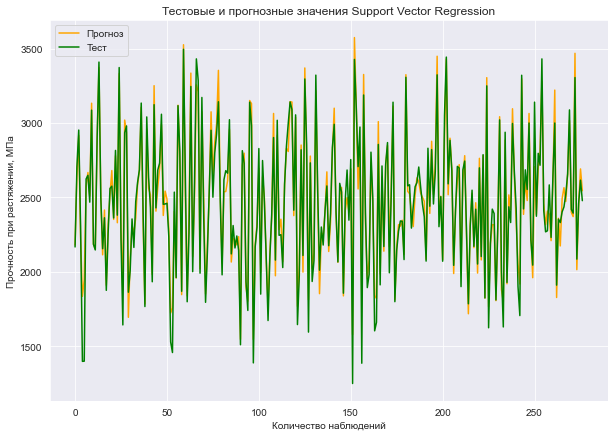

In [95]:
plt.figure(figsize = (10, 7))
plt.title("Тестовые и прогнозные значения Support Vector Regression")
plt.plot(y_pred_svr, label = "Прогноз", color = "orange")
plt.plot(y_test_1.values, label = "Тест", color = "green")
plt.xlabel("Количество наблюдений")
plt.ylabel("Прочность при растяжении, МПа")
plt.legend()
plt.grid(True);

In [96]:
# Метод случайного леса - Random Forest Regressor - 2

In [97]:
#построение модели и вузуализация метода случайный лес
rfr = RandomForestRegressor(n_estimators=15,max_depth=7, random_state=33)
rfr.fit(x_train_1, y_train_1.values)
y_pred_forest = rfr.predict(x_test_1)
mae_rfr = mean_absolute_error(y_pred_forest, y_test_1)
mse_rfr_elast = mean_squared_error(y_test_1,y_pred_forest)
print('Random Forest Regressor Results Train:')
print("Test score: {:.2f}".format(rfr.score(x_train_1, y_train_1))) # Скор для тренировочной выборки
print('Random Forest Regressor Results:')
print('RF_MAE: ', round(mean_absolute_error(y_test_1, y_pred_forest)))
print('RF_MAPE: {:.2f}'.format(mean_absolute_percentage_error(y_test_1, y_pred_forest)))
print('RF_MSE: {:.2f}'.format(mse_rfr_elast))
print("RF_RMSE: {:.2f}".format (np.sqrt(mse_rfr_elast)))
print("Test score: {:.2f}".format(rfr.score(x_test_1, y_test_1))) # Скор для тестовой выборки

Random Forest Regressor Results Train:
Test score: 0.98
Random Forest Regressor Results:
RF_MAE:  77
RF_MAPE: 0.03
RF_MSE: 9651.67
RF_RMSE: 98.24
Test score: 0.95


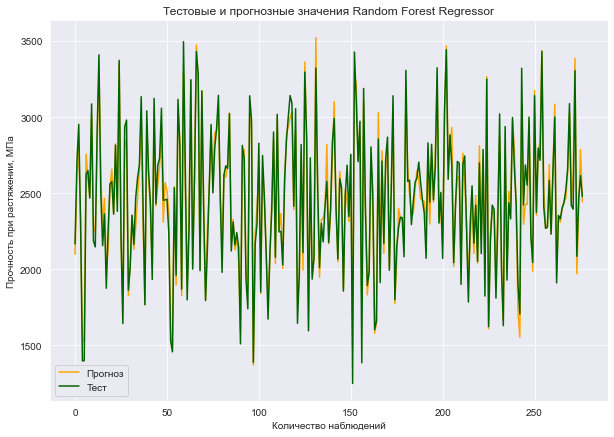

In [98]:
plt.figure(figsize = (10, 7))
plt.title("Тестовые и прогнозные значения Random Forest Regressor")
plt.plot(y_pred_forest, label = "Прогноз", color = "orange")
plt.plot(y_test_1.values, label = "Тест", color = 'darkgreen')
plt.xlabel("Количество наблюдений")
plt.ylabel("Прочность при растяжении, МПа")
plt.legend()
plt.grid(True);

In [99]:
#Метод линейной регрессии - Linear Regression - 3

In [100]:
#построение модели и вузуализация Линейной регрессии
lr = LinearRegression()
lr.fit(x_train_1, y_train_1)
y_pred_lr = lr.predict(x_test_1)
mae_lr = mean_absolute_error(y_pred_lr, y_test_1)
mse_lin_elast = mean_squared_error(y_test_1, y_pred_lr)
print('Linear Regression Results Train:') # Скор для тренировочной выборки
print("Test score: {:.2f}".format(lr.score(x_train_1, y_train_1)))
print('Linear Regression Results:')    
print('lr_MAE: ', round(mean_absolute_error(y_test_1, y_pred_lr)))
print('lr_MAPE: {:.2f}'.format(mean_absolute_percentage_error(y_test_1, y_pred_lr)))
print('lr_MSE: {:.2f}'.format(mse_lin_elast))
print("lr_RMSE: {:.2f}".format (np.sqrt(mse_lin_elast)))
print("Test score: {:.2f}".format(lr.score(x_test_1, y_test_1))) # Скор для тестовой выборки

Linear Regression Results Train:
Test score: 0.97
Linear Regression Results:
lr_MAE:  63
lr_MAPE: 0.03
lr_MSE: 6382.76
lr_RMSE: 79.89
Test score: 0.97


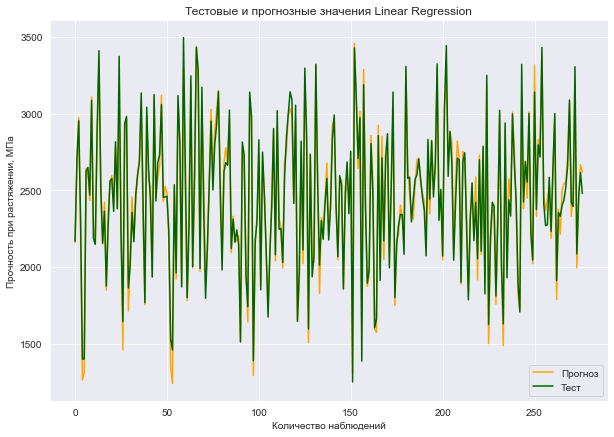

In [101]:
plt.figure(figsize = (10, 7))
plt.title("Тестовые и прогнозные значения Linear Regression")
plt.plot(y_pred_lr, label="Прогноз", color = 'orange')
plt.plot(y_test_1.values, label = "Тест", color = 'darkgreen')
plt.xlabel("Количество наблюдений")
plt.ylabel("Прочность при растяжении, МПа")
plt.legend()
plt.grid(True);

#Линейная регрессия с задачей справилась в 97 % случаев.

In [102]:
#Визуализация гистограммы распределения ошибки

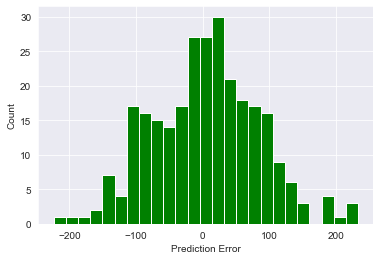

In [103]:
error = y_test_1 - y_pred_lr
plt.hist(error, bins = 25, color = "g")
plt.xlabel('Prediction Error')
_ = plt.ylabel('Count')

In [104]:
#Метода градиентного бустинга - Gradient Boosting Regressor - 4 

In [105]:
gbr = make_pipeline(StandardScaler(), GradientBoostingRegressor())
gbr.fit(x_train_1, np.ravel(y_train_1))
y_pred_gbr = gbr.predict(x_test_1)
mae_gbr = mean_absolute_error(y_pred_gbr, y_test_1)
mse_gbr_elast = mean_squared_error(y_test_1,y_pred_gbr)
print('Gradient Boosting Regressor Results Train:')
print("Test score: {:.2f}".format(gbr.score(x_train_1, y_train_1))) # Скор для тренировочной выборки
print('Gradient Boosting Regressor Results:')
print('GBR_MAE: ', round(mean_absolute_error(y_test_1, y_pred_gbr)))
print('GBR_MAPE: {:.2f}'.format(mean_absolute_percentage_error(y_test_1, y_pred_gbr)))
print('GBR_MSE: {:.2f}'.format(mse_gbr_elast))
print("GBR_RMSE: {:.2f}".format (np.sqrt(mse_gbr_elast)))
print("Test score: {:.2f}".format(gbr.score(x_test_1, y_test_1)))# Скор для тестовой выборки

Gradient Boosting Regressor Results Train:
Test score: 0.99
Gradient Boosting Regressor Results:
GBR_MAE:  61
GBR_MAPE: 0.03
GBR_MSE: 6261.35
GBR_RMSE: 79.13
Test score: 0.97


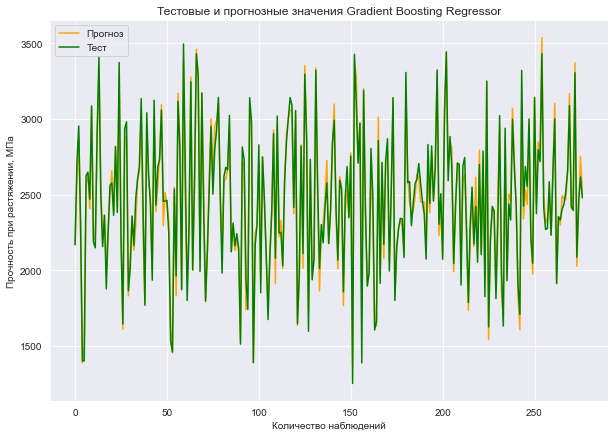

In [106]:
plt.figure(figsize = (10, 7))
plt.title("Тестовые и прогнозные значения Gradient Boosting Regressor")
plt.plot(y_pred_gbr, label = "Прогноз", color = "orange")
plt.plot(y_test_1.values, label = "Тест", color = "green")
plt.xlabel("Количество наблюдений")
plt.ylabel("Прочность при растяжении, МПа")
plt.legend()
plt.grid(True);
#Градиентный бустинг с задачей справился в 97 % случаев.

In [107]:
# Метод К ближайших соседей - K Neighbors Regressor - 5
knn = KNeighborsRegressor(n_neighbors=5)
knn.fit(x_train_1, y_train_1)
y_pred_knn = knn.predict(x_test_1)
mae_knr = mean_absolute_error(y_pred_knn, y_test_1)
mse_knn_elast = mean_squared_error(y_test_1,y_pred_knn)
print('K Neighbors Regressor  Results Train:')
print("Test score: {:.2f}".format(knn.score(x_train_1, y_train_1)))# Скор для тренировочной выборки
print('K Neighbors Regressor  Results:')
print('KNN_MAE: ', round(mean_absolute_error(y_test_1, y_pred_knn)))
print('KNN_MAPE: {:.2f}'.format(mean_absolute_percentage_error(y_test_1, y_pred_knn)))
print('KNN_MSE: {:.2f}'.format(mse_knn_elast))
print("KNN_RMSE: {:.2f}".format (np.sqrt(mse_knn_elast)))
print("Test score: {:.2f}".format(knn.score(x_test_1, y_test_1)))# Скор для тестовой выборки

K Neighbors Regressor  Results Train:
Test score: 0.92
K Neighbors Regressor  Results:
KNN_MAE:  122
KNN_MAPE: 0.05
KNN_MSE: 25243.37
KNN_RMSE: 158.88
Test score: 0.88


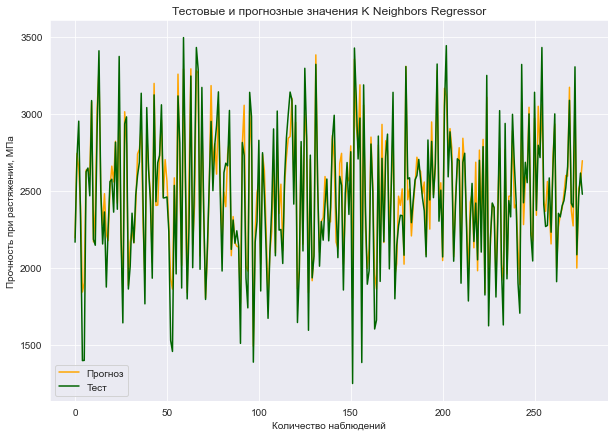

In [108]:
plt.figure(figsize = (10, 7))
plt.title("Тестовые и прогнозные значения K Neighbors Regressor")
plt.plot(y_pred_knn, label = "Прогноз", color = 'orange')
plt.plot(y_test_1.values, label = "Тест", color = 'darkgreen')
plt.xlabel("Количество наблюдений")
plt.ylabel("Прочность при растяжении, МПа")
plt.legend()
plt.grid(True);

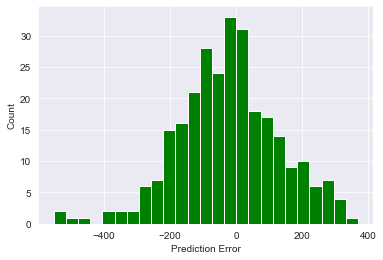

In [109]:
#Визуализация гистограммы распределения ошибки
error = y_test_1 - y_pred_knn
plt.hist(error, bins = 25, color = "g")
plt.xlabel('Prediction Error')
_ = plt.ylabel('Count')

In [110]:
#Деревья решений - Decision Tree Regressor - 6

dtr = DecisionTreeRegressor()
dtr.fit(x_train_1, y_train_1.values)
y_pred_dtr = dtr.predict(x_test_1)
mae_dtr = mean_absolute_error(y_pred_dtr, y_test_1)
mse_dtr_elast = mean_squared_error(y_test_1,y_pred_dtr)
print('Decision Tree Regressor Results Train:')
print("Test score: {:.2f}".format(knn.score(x_train_1, y_train_1)))# Скор для тренировочной выборки
print('Decision Tree Regressor Results:')
print('DTR_MAE: ', round(mean_absolute_error(y_test_1, y_pred_dtr)))
print('DTR_MSE: {:.2f}'.format(mse_dtr_elast))
print("DTR_RMSE: {:.2f}".format (np.sqrt(mse_dtr_elast)))
print('DTR_MAPE: {:.2f}'.format(mean_absolute_percentage_error(y_test_1, y_pred_dtr)))
print("Test score: {:.2f}".format(dtr.score(x_test_1, y_test_1)))# Скор для тестовой выборки

Decision Tree Regressor Results Train:
Test score: 0.92
Decision Tree Regressor Results:
DTR_MAE:  113
DTR_MSE: 21371.25
DTR_RMSE: 146.19
DTR_MAPE: 0.05
Test score: 0.90


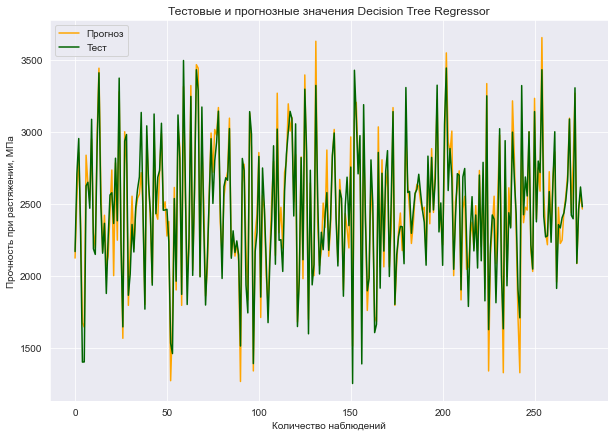

In [111]:
plt.figure(figsize = (10, 7))
plt.title("Тестовые и прогнозные значения Decision Tree Regressor")
plt.plot(y_pred_dtr, label = "Прогноз", color = 'orange')
plt.plot(y_test_1.values, label = "Тест", color = 'darkgreen')
plt.xlabel("Количество наблюдений")
plt.ylabel("Прочность при растяжении, МПа")
plt.legend()
plt.grid(True);

In [112]:
# Стохастический градиентный спуск (SGD) - Stochastic Gradient Descent Regressor - 7 

sdg = SGDRegressor()
sdg.fit(x_train_1, y_train_1)
y_pred_sdg = sdg.predict(x_test_1)
mae_sdg = mean_absolute_error(y_pred_sdg, y_test_1)
mse_sdg_elast = mean_squared_error(y_test_1,y_pred_sdg)
print('Stochastic Gradient Descent Regressor Results Train:')
print("Test score: {:.2f}".format(sdg.score(x_train_1, y_train_1)))# Скор для тренировочной выборки
print('Stochastic Gradient Descent Regressor Results:')
print('SGD_MAE: ', round(mean_absolute_error(y_test_1, y_pred_sdg)))
print('SGD_MSE: {:.2f}'.format(mse_sdg_elast))
print("SGD_RMSE: {:.2f}".format (np.sqrt(mse_sdg_elast)))
print('SGD_MAPE: {:.2f}'.format(mean_absolute_percentage_error(y_test_1, y_pred_sdg)))
print("Test score: {:.2f}".format(sdg.score(x_test_1, y_test_1)))# Скор для тестовой выборки

Stochastic Gradient Descent Regressor Results Train:
Test score: 0.72
Stochastic Gradient Descent Regressor Results:
SGD_MAE:  189
SGD_MSE: 56271.38
SGD_RMSE: 237.22
SGD_MAPE: 0.08
Test score: 0.74


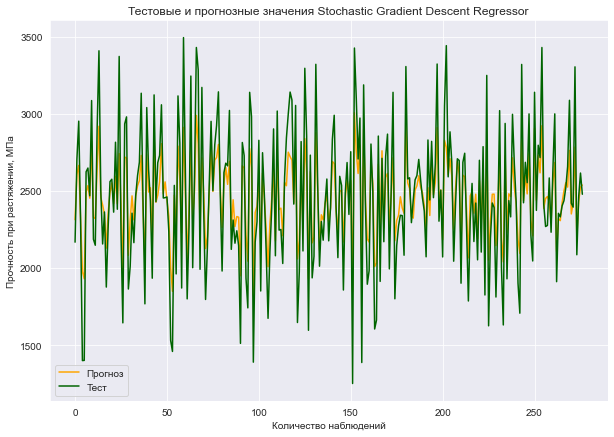

In [113]:
plt.figure(figsize = (10, 7))
plt.title("Тестовые и прогнозные значения Stochastic Gradient Descent Regressor")
plt.plot(y_pred_sdg, label = "Прогноз", color = 'orange')
plt.plot(y_test_1.values, label = "Тест", color = 'darkgreen')
plt.xlabel("Количество наблюдений")
plt.ylabel("Прочность при растяжении, МПа")
plt.legend()
plt.grid(True);

In [114]:
# Многослойный перцептрон - Multi-layer Perceptron regressor - 8

mlp = MLPRegressor(random_state = 1, max_iter = 500)
mlp.fit(x_train_1, y_train_1)
y_pred_mlp = mlp.predict(x_test_1)
mae_mlp = mean_absolute_error(y_pred_mlp, y_test_1)
mse_mlp_elast = mean_squared_error(y_test_1,y_pred_mlp)
print('Multi-layer Perceptron regressor Results Train:')
print("Test score: {:.2f}".format(mlp.score(x_train_1, y_train_1)))# Скор для тренировочной выборки
print('Multi-layer Perceptron regressor Results:')
print('SGD_MAE: ', round(mean_absolute_error(y_test_1, y_pred_mlp)))
print('SGD_MAPE: {:.2f}'.format(mean_absolute_percentage_error(y_test_1, y_pred_mlp)))
print('SGD_MSE: {:.2f}'.format(mse_mlp_elast))
print("SGD_RMSE: {:.2f}".format (np.sqrt(mse_mlp_elast)))
print("Test score: {:.2f}".format(mlp.score(x_test_1, y_test_1)))# Скор для тестовой выборки

Multi-layer Perceptron regressor Results Train:
Test score: -13.11
Multi-layer Perceptron regressor Results:
SGD_MAE:  1619
SGD_MAPE: 0.64
SGD_MSE: 2880353.81
SGD_RMSE: 1697.16
Test score: -12.46


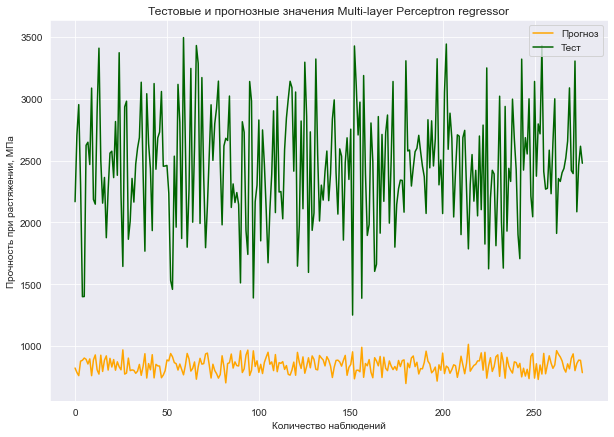

In [115]:
plt.figure(figsize = (10, 7))
plt.title("Тестовые и прогнозные значения Multi-layer Perceptron regressor")
plt.plot(y_pred_mlp, label = "Прогноз", color = 'orange')
plt.plot(y_test_1.values, label = "Тест", color = 'darkgreen')
plt.xlabel("Количество наблюдений")
plt.ylabel("Прочность при растяжении, МПа")
plt.legend()
plt.grid(True);

In [116]:
# Лассо регрессия - the Lasso - 9

clf = linear_model.Lasso(alpha=0.1)
clf.fit(x_train_1, y_train_1)
y_pred_clf = clf.predict(x_test_1)
mae_clf = mean_absolute_error(y_pred_clf, y_test_1)
mse_clf_elast = mean_squared_error(y_test_1,y_pred_clf)
print('Lasso regressor Results Train:')
print("Test score: {:.2f}".format(clf.score(x_train_1, y_train_1)))# Скор для тренировочной выборки
print('Lasso regressor Results:')
print('SGD_MAE: ', round(mean_absolute_error(y_test_1, y_pred_clf)))
print('SGD_MAPE: {:.2f}'.format(mean_absolute_percentage_error(y_test_1, y_pred_clf)))
print('SGD_MSE: {:.2f}'.format(mse_clf_elast))
print("SGD_RMSE: {:.2f}".format (np.sqrt(mse_clf_elast)))
print("Test score: {:.2f}".format(clf.score(x_test_1, y_test_1)))# Скор для тестовой выборки

Lasso regressor Results Train:
Test score: 0.95
Lasso regressor Results:
SGD_MAE:  70
SGD_MAPE: 0.03
SGD_MSE: 7993.22
SGD_RMSE: 89.40
Test score: 0.96


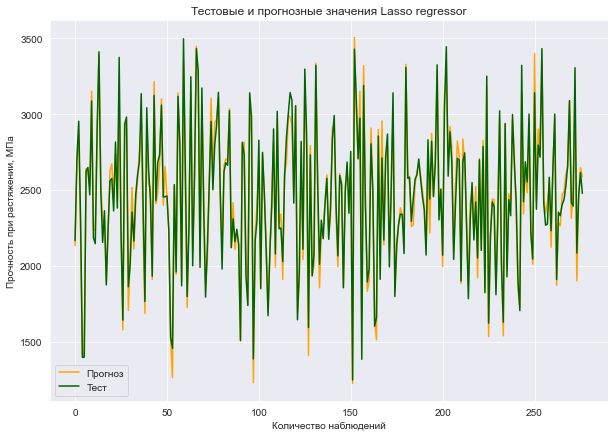

In [117]:
plt.figure(figsize = (10, 7))
plt.title("Тестовые и прогнозные значения Lasso regressor")
plt.plot(y_pred_clf, label = "Прогноз", color = 'orange')
plt.plot(y_test_1.values, label = "Тест", color = 'darkgreen')
plt.xlabel("Количество наблюдений")
plt.ylabel("Прочность при растяжении, МПа")
plt.legend()
plt.grid(True);

In [118]:
#сравним наши модели по метрике МАЕ
mae_df = {'Регрессор': ['Support Vector', 'RandomForest', 'Linear Regression', 'GradientBoosting', 'KNeighbors', 'DecisionTree', 'SGD', 'MLP', 'Lasso'], 'MAE': [mae_svr, mae_rfr, mae_lr, mae_gbr, mae_knr, mae_dtr, mae_sdg, mae_mlp, mae_clf]} 

mae_df = pd.DataFrame(mae_df)

In [119]:
mae_df

,Регрессор,MAE
0,Support Vector,76.111030
1,RandomForest,76.531400
2,Linear Regression,63.456419
3,GradientBoosting,61.110269
4,KNeighbors,122.095974
5,DecisionTree,113.159004
6,SGD,189.206680
7,MLP,1619.254573
8,Lasso,70.176750


In [120]:
# Поиск оптимальных гиперпараметров.
# В машинном обучении гиперпараметрами называют параметры алгоритмов, значения которых устанавливаются перед запуском процесса обучения. 
# В этом смысле они и отличаются от обычных параметров, вычисляемых в процессе обучения. Гиперпараметры используются для управления процессом обучения.
#Один из способов настройки гиперпараметров состоит в том, чтобы заставить компьютер попробовать все возможные комбинации значений параметров. 
#Для этого используем модуль GridSearchCV из библиотеки Scikit Learn. Попытаемся найти наилучшую комбинацию гиперпараметров для построения классификатора для нашего набора данных.
#Метод GridSearch:
#ПЛЮСЫ: Этот метод получит требуемые оптимальные гиперпараметры.
#МИНУСЫ: Операция является исчерпывающей. Если диапазон или число гиперпараметров велики, то вероятности могут исчисляться миллионами, и на завершение потребуется довольно много времени.

In [121]:
# Проведем поиск  по сетке гиперпараметров с перекрестной проверкой, количество блоков равно 10 (cv = 10), для 
# модели случайного леса - Random Forest Regressor - 2

parametrs = { 'n_estimators': [200, 300],
              'max_depth': [9, 15],
              'max_features': ['auto'],
              'criterion': ['mse'] }
grid = GridSearchCV(estimator = rfr, param_grid = parametrs, cv = 10)
grid.fit(x_train_1, y_train_1)

GridSearchCV(cv=10,
             estimator=RandomForestRegressor(max_depth=7, n_estimators=15,
                                             random_state=33),
             param_grid={'criterion': ['mse'], 'max_depth': [9, 15],
                         'max_features': ['auto'], 'n_estimators': [200, 300]})

In [122]:
grid.best_params_

{'criterion': 'mse',
 'max_depth': 15,
 'max_features': 'auto',
 'n_estimators': 300}

In [123]:
#Выводим гиперпараметры для оптимальной модели
print(grid.best_estimator_)
knr_upr = grid.best_estimator_
print(f'R2-score RFR для прочности при растяжении, МПа: {knr_upr.score(x_test_1, y_test_1).round(3)}')

RandomForestRegressor(criterion='mse', max_depth=15, n_estimators=300,
                      random_state=33)
R2-score RFR для прочности при растяжении, МПа: 0.962


In [124]:
#подставим оптимальные гиперпараметры в нашу модель случайного леса
rfr_grid = RandomForestRegressor(n_estimators = 200, criterion = 'mse', max_depth = 15, max_features = 'auto')
#Обучаем модель
rfr_grid.fit(x_train_1, y_train_1)

predictions_rfr_grid = rfr_grid.predict(x_test_1)
#Оцениваем точность на тестовом наборе
mae_rfr_grid = mean_absolute_error(predictions_rfr_grid, y_test_1)
mae_rfr_grid

72.08635818902486

In [125]:
new_row_in_mae_df = {'Регрессор': 'RandomForest_GridSearchCV', 'MAE': mae_rfr_grid} 

mae_df = mae_df.append(new_row_in_mae_df, ignore_index=True)

In [126]:
# поиск гипермараметров не дал улучшений для уже имеющейся модели RandomForestRegressor
# вероятно, нужно указывать больше вариаций параметров при работе с GridSearchCV
mae_df

,Регрессор,MAE
0,Support Vector,76.111030
1,RandomForest,76.531400
2,Linear Regression,63.456419
3,GradientBoosting,61.110269
4,KNeighbors,122.095974
5,DecisionTree,113.159004
6,SGD,189.206680
7,MLP,1619.254573
8,Lasso,70.176750
9,RandomForest_GridSearchCV,72.086358


In [127]:
# Проведем поиск  по сетке гиперпараметров с перекрестной проверкой, количество блоков равно 10 (cv = 10), для 
# Метода К ближайших соседей - K Neighbors Regressor - 5
knn = KNeighborsRegressor()
knn_params = {'n_neighbors' : range(1, 301, 2), 
          'weights' : ['uniform', 'distance'],
          'algorithm' : ['auto', 'ball_tree', 'kd_tree', 'brute']
          }
#Запустим обучение модели. В качестве оценки модели будем использовать коэффициент детерминации (R^2)
# Если R2<0, это значит, что разработанная модель даёт прогноз даже хуже, чем простое усреднение.
gs = GridSearchCV(knn, knn_params, cv = 10, verbose = 1, n_jobs =-1, scoring = 'r2')
gs.fit(x_train_1, y_train_1)
knn_3 = gs.best_estimator_
gs.best_params_

Fitting 10 folds for each of 1200 candidates, totalling 12000 fits


{'algorithm': 'brute', 'n_neighbors': 5, 'weights': 'distance'}

In [128]:
#Выводим гиперпараметры для оптимальной модели
print(gs.best_estimator_)
gs1 = gs.best_estimator_
print(f'R2-score KNR для прочности при растяжении, МПа: {gs1.score(x_test_1, y_test_1).round(3)}')

KNeighborsRegressor(algorithm='brute', weights='distance')
R2-score KNR для прочности при растяжении, МПа: 0.888


In [129]:
#подставим оптимальные гиперпараметры в нашу модель метода к ближайших соседей
knn_grid = KNeighborsRegressor(algorithm = 'brute', n_neighbors = 7, weights = 'distance')
#Обучаем модель
knn_grid.fit(x_train_1, y_train_1)

predictions_knn_grid = knn_grid.predict(x_test_1)
#Оцениваем точность на тестовом наборе
mae_knn_grid = mean_absolute_error(predictions_knn_grid, y_test_1)
mae_knn_grid

110.7337743880438

In [130]:
new_row_in_mae_df = {'Регрессор': 'KNeighbors_GridSearchCV', 'MAE': mae_knn_grid} 

mae_df = mae_df.append(new_row_in_mae_df, ignore_index=True)
mae_df

,Регрессор,MAE
0,Support Vector,76.111030
1,RandomForest,76.531400
2,Linear Regression,63.456419
3,GradientBoosting,61.110269
4,KNeighbors,122.095974
5,DecisionTree,113.159004
6,SGD,189.206680
7,MLP,1619.254573
8,Lasso,70.176750
9,RandomForest_GridSearchCV,72.086358


In [131]:
# Проведем поиск  по сетке гиперпараметров с перекрестной проверкой, количество блоков равно 10 (cv = 10), для 
#Деревья решений - Decision Tree Regressor - 6
criterion = ['squared_error', 'friedman_mse', 'absolute_error', 'poisson']
splitter = ['best', 'random']
max_depth = [3,5,7,9,11]
min_samples_leaf = [100,150,200]
min_samples_split = [200,250,300]
max_features = ['auto', 'sqrt', 'log2']
param_grid = {'criterion': criterion,
               'splitter': splitter,
               'max_depth': max_depth,
               'min_samples_split': min_samples_split,
               'min_samples_leaf': min_samples_leaf,
               'max_features': max_features}
#Запустим обучение модели. В качестве оценки модели будем использовать коэффициент детерминации (R^2)
# Если R2<0, это значит, что разработанная модель даёт прогноз даже хуже, чем простое усреднение.
gs4 = GridSearchCV(dtr, param_grid, cv = 10, verbose = 1, n_jobs =-1, scoring = 'r2')
gs4.fit(x_train_1, y_train_1)
dtr_3 = gs4.best_estimator_
gs.best_params_

Fitting 10 folds for each of 1080 candidates, totalling 10800 fits


{'algorithm': 'brute', 'n_neighbors': 5, 'weights': 'distance'}

In [132]:
#Выводим гиперпараметры для оптимальной модели
print(gs4.best_estimator_)
gs1 = gs4.best_estimator_
print(f'R2-score DTR для прочности при растяжении, МПа: {gs4.score(x_test_1, y_test_1).round(3)}')

DecisionTreeRegressor(criterion='poisson', max_depth=5, max_features='auto',
                      min_samples_leaf=100, min_samples_split=200)
R2-score DTR для прочности при растяжении, МПа: 0.821


In [133]:
#подставим оптимальные гиперпараметры в нашу модель метода деревья решений
dtr_grid = DecisionTreeRegressor(criterion = 'poisson', max_depth = 7, max_features = 'auto',
                      min_samples_leaf = 100, min_samples_split = 250)
#Обучаем модель
dtr_grid.fit(x_train_1, y_train_1)

predictions_dtr_grid = dtr_grid.predict(x_test_1)
#Оцениваем точность на тестовом наборе
mae_dtr_grid = mean_absolute_error(predictions_dtr_grid, y_test_1)
mae_dtr_grid

169.60058525087166

In [134]:
new_row_in_mae_df = {'Регрессор': 'DecisionTree_GridSearchCV', 'MAE': mae_dtr_grid} 

mae_df = mae_df.append(new_row_in_mae_df, ignore_index = True)
mae_df

,Регрессор,MAE
0,Support Vector,76.111030
1,RandomForest,76.531400
2,Linear Regression,63.456419
3,GradientBoosting,61.110269
4,KNeighbors,122.095974
5,DecisionTree,113.159004
6,SGD,189.206680
7,MLP,1619.254573
8,Lasso,70.176750
9,RandomForest_GridSearchCV,72.086358


In [135]:
pipe = Pipeline([('preprocessing', StandardScaler()), ('regressor', SVR())])
param_grid = [
{'regressor': [SVR()], 'preprocessing': [StandardScaler(), MinMaxScaler(), None],
'regressor__gamma': [0.001, 0.01, 0.1, 1, 10, 100],
'regressor__C': [0.001, 0.01, 0.1, 1, 10, 100]},
{'regressor': [RandomForestRegressor(n_estimators = 100)],
'preprocessing':  [StandardScaler(), MinMaxScaler(), None]},
{'regressor': [LinearRegression()], 'preprocessing':  [StandardScaler(), MinMaxScaler(), None]},
{'regressor': [GradientBoostingRegressor()], 'preprocessing':  [StandardScaler(), MinMaxScaler(), None]},
{'regressor': [KNeighborsRegressor()], 'preprocessing':  [StandardScaler(), MinMaxScaler(), None]},
{'regressor': [DecisionTreeRegressor()], 'preprocessing':  [StandardScaler(), MinMaxScaler(), None]},
{'regressor': [SGDRegressor()], 'preprocessing':  [StandardScaler(), MinMaxScaler(), None]},
{'regressor': [MLPRegressor(random_state = 1, max_iter = 500)], 'preprocessing':  [StandardScaler(), MinMaxScaler(), None]},
{'regressor': [linear_model.Lasso(alpha = 0.1)], 'preprocessing':  [StandardScaler(), MinMaxScaler(), None]},]
grid = GridSearchCV(pipe, param_grid, cv = 10)
grid.fit(x_train_1, np.ravel(y_train_1))
print("Наилучшие параметры:\n{}\n".format(grid.best_params_))
print("Наилучшее значение правильности перекрестной проверки: {:.2f}".format(grid.best_score_))
print("Правильность на тестовом наборе: {:.2f}".format(grid.score(x_test_1, y_test_1)))

Наилучшие параметры:
{'preprocessing': None, 'regressor': GradientBoostingRegressor()}

Наилучшее значение правильности перекрестной проверки: 0.97
Правильность на тестовом наборе: 0.97


In [136]:
print("Наилучшая модель:\n{}".format(grid.best_estimator_))

Наилучшая модель:
Pipeline(steps=[('preprocessing', None),
                ('regressor', GradientBoostingRegressor())])
